<a href="https://colab.research.google.com/github/bilalze/Arrow_Hurwichz/blob/main/DNNFinalProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<a href="https://colab.research.google.com/github/DataScienceAndEngineering/deep-learning-final-project-project-2-architecture-stuff/blob/main/DNNFinalProject.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

In [ ]:
#@markdown Check type of GPU and VRAM available.
!nvidia-smi --query-gpu=name,memory.total,memory.free --format=csv,noheader

Tesla T4, 15360 MiB, 15101 MiB


# Install Requirement

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Requirements

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
import os
import matplotlib.pyplot as plt
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input


In [ ]:
num_classes = 25 #Use the arcDataset
batch_size = 32

In [ ]:


def load_image_data(filename, path='', img_height=512, img_width=512, batch_size=32, validation_split=0.2, test_split=0.1, random_state=42, class_modes = 'categorical'):
    """
    Load image data from a CSV file and split into train, validation, and test sets.

    Args:
    - filename (str): path to the CSV file
    - path (str): pre-existing path to concatenate with filename in each row (default: '')
    - img_height (int): height to resize the images to (default: 256)
    - img_width (int): width to resize the images to (default: 256)
    - batch_size (int): batch size for the ImageDataGenerator (default: 32)
    - validation_split (float): fraction of data to use for validation (default: 0.2)
    - test_split (float): fraction of data to use for test (default: 0.1)
    - random_state (int): random state for train_test_split() (default: 42)

    Returns:
    - train_gen (ImageDataGenerator): ImageDataGenerator containing the training data
    - val_gen (ImageDataGenerator): ImageDataGenerator containing the validation data
    - test_gen (ImageDataGenerator): ImageDataGenerator containing the test data
    """
    # load CSV file as pandas dataframe
    df = pd.read_csv(filename)

    # convert label column to string
    df['label'] = df['label'].astype(str)

    # # create list of image filenames
    img_files = [os.path.join(path, fname) for fname in df['filename'].tolist()]

    validPaths = check_file_paths(img_files)
    print(len(validPaths))

    df['filename'] = img_files

    # split data into train and test sets
    train_df, test_df = train_test_split(df, test_size=test_split, random_state=random_state)

    # split train set into train and validation sets
    train_df, val_df = train_test_split(train_df, test_size=validation_split, random_state=random_state)

    # Set up data generators for training and validation
    train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
    val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
    test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

    # create TensorFlow generators from dataframes
    train_gen = train_datagen.flow_from_dataframe(
        dataframe=train_df,
        directory=None,
        x_col='filename',
        y_col='label',
        class_mode= class_modes,
        target_size=(img_height, img_width),
        batch_size=batch_size
    )

    val_gen = val_datagen.flow_from_dataframe(
        dataframe=val_df,
        directory=None,
        x_col='filename',
        y_col='label',
        class_mode=class_modes,
        target_size=(img_height, img_width),
        batch_size=batch_size
    )

    test_gen = test_datagen.flow_from_dataframe(
        dataframe=test_df,
        directory=None,
        x_col='filename',
        y_col='label',
        class_mode=class_modes,
        target_size=(img_height, img_width),
        batch_size=batch_size
    )

    return train_gen, val_gen, test_gen


def check_file_paths(file_paths):
    """
    Check whether a list of file paths is valid.

    Args:
    - file_paths (list of str): list of file paths to check

    Returns:
    - valid_paths (list of str): list of valid file paths
    """
    valid_paths = []
    for path in file_paths:
        if os.path.isfile(path):
            valid_paths.append(path)
    return valid_paths

In [ ]:
filename = '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/labels_refined.csv'
path = '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/Data/arcDataset_resize/'
df = pd.read_csv(filename)
img_path = os.path.join(path, df['filename'][0])
print(img_path)

/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/Data/arcDataset_resize/Art Nouveau architecture/4728_450px-7%2C_Franka_Street%2C_Lviv.jpg


#Model Exploration - Feature Extraction

##Test with Resnet Layer for classification

In [ ]:
train_generator, val_generator, test_generator = load_image_data(filename, path)

3528
Found 2540 validated image filenames belonging to 25 classes.
Found 635 validated image filenames belonging to 25 classes.
Found 353 validated image filenames belonging to 25 classes.


In [ ]:
#Using ResNet50 as the backbone

#Waiting for the dataset to be finished
#Load the ResNet50 Model with 512*512 input shape and imagenet weights 
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(512, 512, 3))

#add the new classification layers
x = base_model.output
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(1024, activation='relu')(x)
preds = tf.keras.layers.Dense(num_classes, activation='softmax')(x)


#create the new model
model = tf.keras.models.Model(inputs=base_model.input, outputs=preds)

#freeze the base model layers
for layer in base_model.layers:
    layer.trainable = False

#compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])


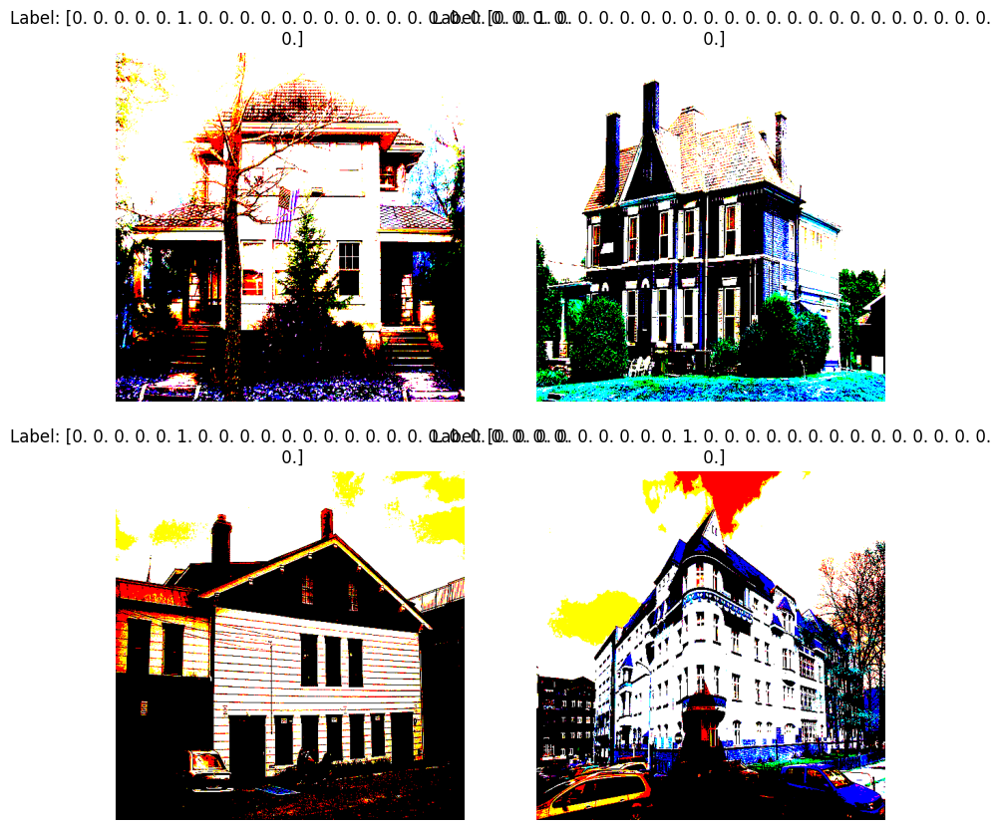

In [ ]:

def check_gen(train_gen):
    """
    Check the first four images in the set using Matplotlib.

    Args:
    - train_gen (ImageDataGenerator): ImageDataGenerator containing the data
    """
    # get the first batch of images from the generator
    img_batch, label_batch = next(train_gen)

    # plot the first four images
    plt.figure(figsize=(10, 10))
    for i in range(4):
        ax = plt.subplot(2, 2, i + 1)
        plt.imshow(img_batch[i])
        plt.title(f'Label: {label_batch[i]}')
        plt.axis('off')

check_gen(train_generator)

In [ ]:
# Train the model
model.fit(
    train_generator,
    steps_per_epoch=train_generator.n // batch_size,
    epochs=5,
    validation_data=val_generator,
    validation_steps=val_generator.n // batch_size)

# Save the model
model.save('arcDataset_fine_tuned_resnet50.h5')

Epoch 1/5
79/79 [==============================] - 605s 8s/step - loss: 1.7695 - accuracy: 0.4916 - val_loss: 1.2841 - val_accuracy: 0.5872
Epoch 2/5
79/79 [==============================] - 74s 937ms/step - loss: 0.8686 - accuracy: 0.7233 - val_loss: 1.2235 - val_accuracy: 0.6480
Epoch 3/5
79/79 [==============================] - 74s 937ms/step - loss: 0.6622 - accuracy: 0.7871 - val_loss: 0.9730 - val_accuracy: 0.7007
Epoch 4/5
79/79 [==============================] - 74s 941ms/step - loss: 0.4427 - accuracy: 0.8716 - val_loss: 0.9877 - val_accuracy: 0.6776
Epoch 5/5
79/79 [==============================] - 74s 939ms/step - loss: 0.3473 - accuracy: 0.8975 - val_loss: 0.9971 - val_accuracy: 0.7204


In [ ]:
!cp arcDataset_fine_tuned_resnet50.h5 '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/'

##Model Layer exploration to find the relevant features

In [ ]:
#Load the model from google drive
!cp '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/arcDataset_fine_tuned_resnet50.h5' /content/

from tensorflow.keras.models import load_model

model =load_model('arcDataset_fine_tuned_resnet50.h5')


1/1 [==============================] - 0s 424ms/step


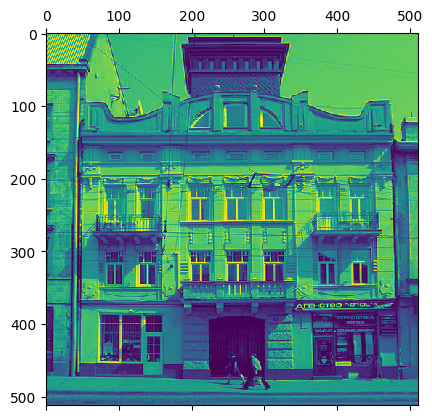

In [ ]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# visualize feature maps in the first convolutional layer
layer_outputs = [layer.output for layer in model.layers[:8]]
activation_model = Model(inputs=model.input, outputs=layer_outputs)
img = load_img(img_path, target_size=(512, 512))
x = img_to_array(img)
x = x.reshape((1,) + x.shape)
x /= 255
activations = activation_model.predict(x)
first_layer_activation = activations[0]
plt.matshow(first_layer_activation[0, :, :, 1], cmap='viridis')
plt.show()


In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 518, 518, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 256, 256, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                            

1/1 [==============================] - 4s 4s/step


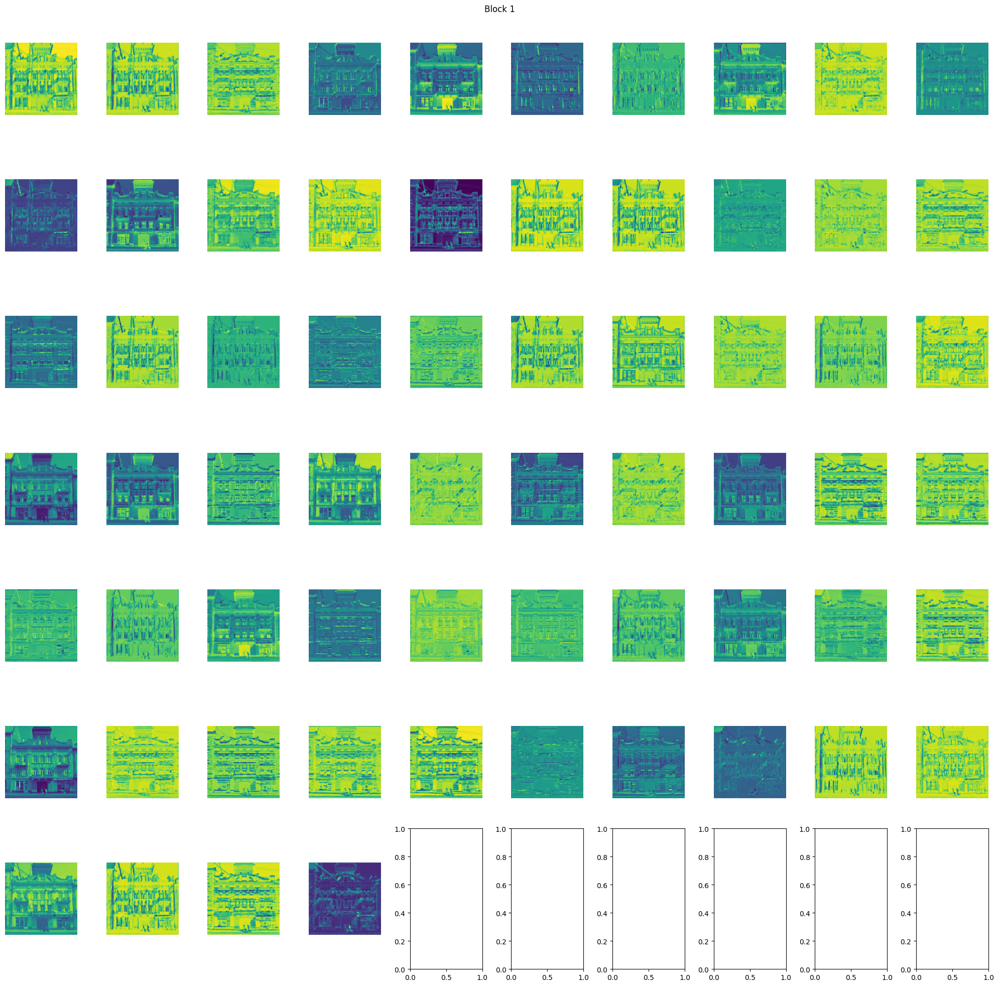

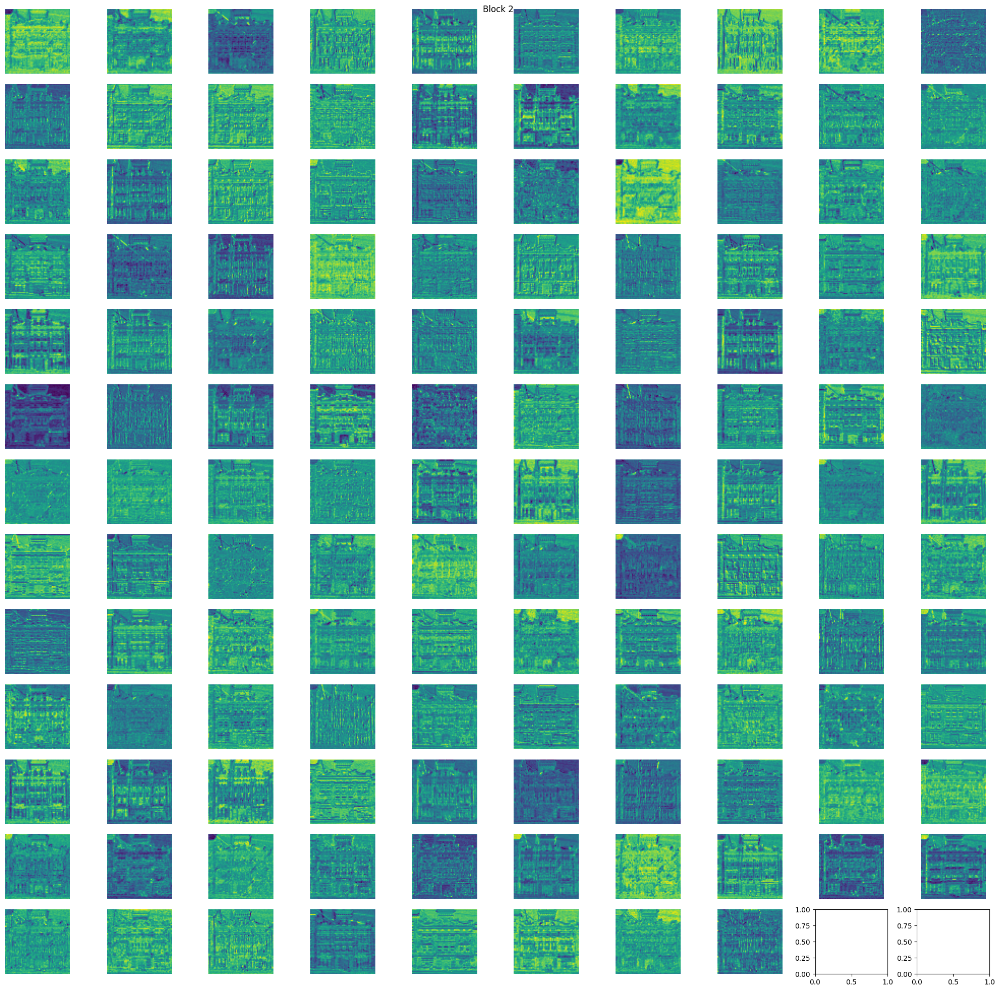

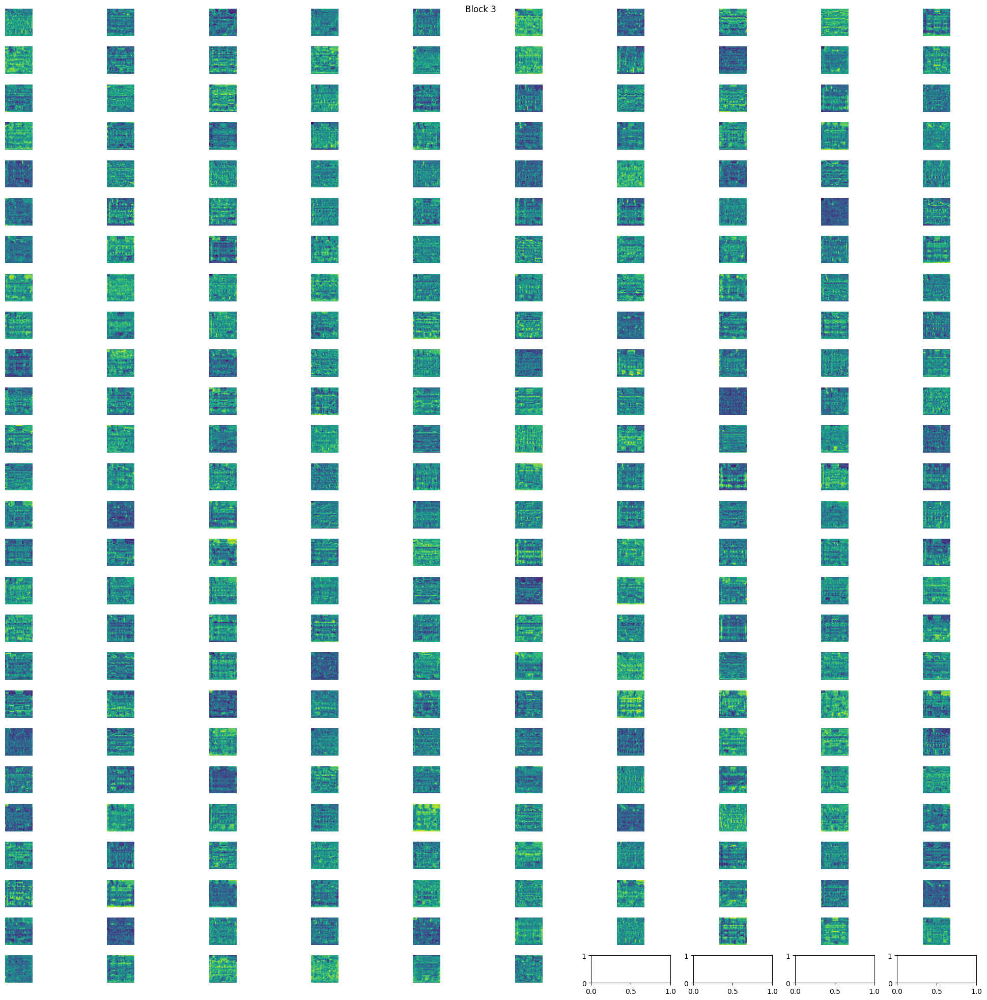

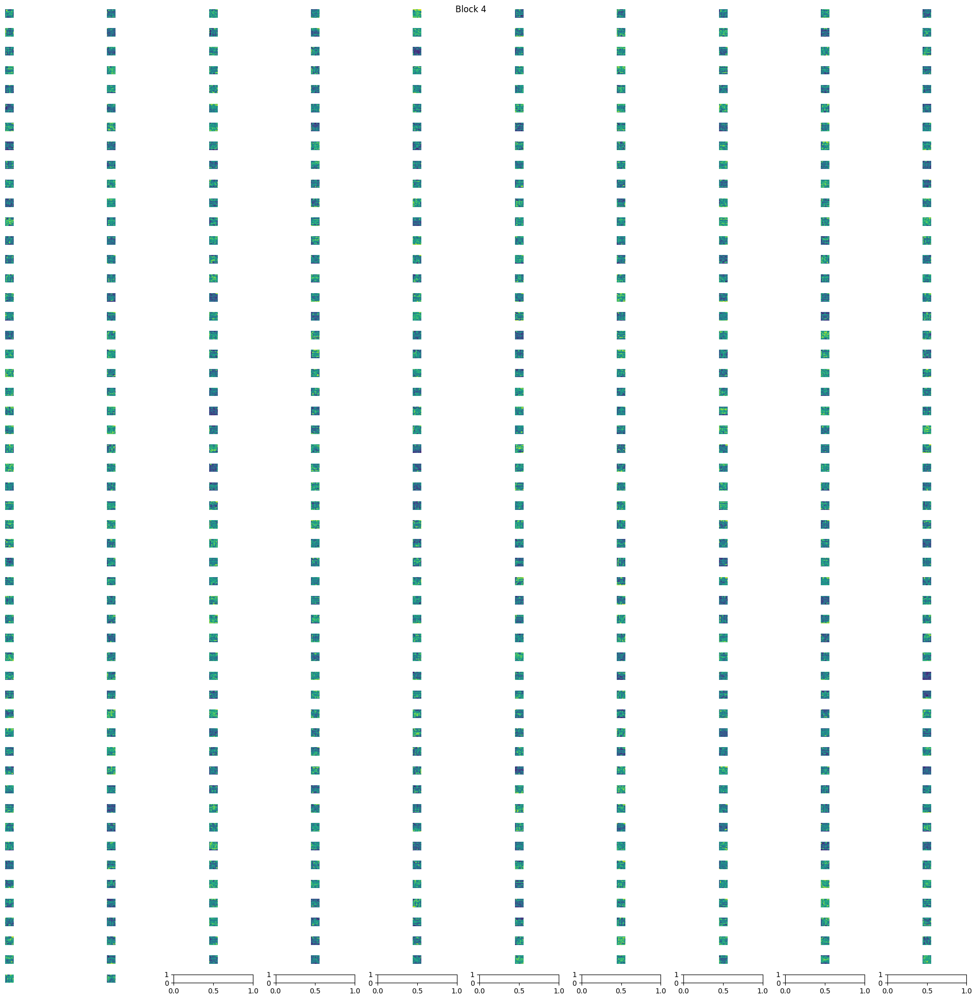

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
import math

# Define the activation model to output the feature maps of all blocks
block_outputs = [layer.output for layer in model.layers if 'block1_1_conv' in layer.name]
activation_model = tf.keras.models.Model(inputs=model.input, outputs=block_outputs)

# Load an example image and preprocess it
img = load_img(img_path, target_size=(512, 512))
x = img_to_array(img)
x = tf.keras.applications.resnet50.preprocess_input(x)
x = tf.expand_dims(x, axis=0)

# Compute the feature maps for all blocks
block_activations = activation_model.predict(x)

# Visualize the output of each block
for i, block_activation in enumerate(block_activations):
    n_features = block_activation.shape[-1]
    fig, axs = plt.subplots(math.ceil(n_features/10), 10, figsize=(20, 20))
    fig.suptitle('Block %d' % (i+1))
    axs = axs.ravel()
    for j in range(n_features):
        axs[j].imshow(block_activation[0, :, :, j], cmap='viridis', aspect='auto')
        axs[j].set_aspect('equal')
        axs[j].axis('off')
    plt.tight_layout()
    plt.show()

It seems that there are way too many images to check on which layer to choose from. I will use a different technique CNN variational autoencoder

## MobileNet based VAE

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, Model
# from tensorflow.keras.applications import ResNet50
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.callbacks import ModelCheckpoint


In [ ]:
class Sampling(layers.Layer):
    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon


def build_vae_encoder(input_shape, latent_dim):
    model = MobileNetV2(include_top=False, weights='imagenet', input_shape=input_shape)
    
    x = model.output
    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(512, activation='relu')(x)
    
    z_mean = layers.Dense(latent_dim, name='z_mean')(x)
    z_log_var = layers.Dense(latent_dim, name='z_log_var')(x)
    z = Sampling()([z_mean, z_log_var])

    encoder = Model(inputs=model.input, outputs=[z_mean, z_log_var, z], name='vae_encoder')
    
    return encoder


def build_vae_decoder(input_shape, latent_dim):
    decoder_input = layers.Input(shape=(latent_dim,))
    x = layers.Dense(input_shape[0] // 8 * input_shape[1] // 8 * 128, activation='relu')(decoder_input)
    x = layers.Reshape((input_shape[0] // 8, input_shape[1] // 8, 128))(x)

    # Add blocks of UpSampling2D and SeparableConv2D layers
    for filters in [64, 32, 16]:
        x = layers.UpSampling2D((2, 2))(x)
        x = layers.Conv2DTranspose(filters, (3, 3), activation='relu', padding='same')(x)
        x = layers.Conv2DTranspose(filters, (3, 3), activation='relu', padding='same')(x)

    x = layers.Conv2DTranspose(input_shape[2], kernel_size=3, activation='tanh', padding='same')(x)

    # x = layers.Conv2DTranspose(3, kernel_size=3, activation=None, padding='same')(x)

    decoder_output = x
    decoder = Model(decoder_input, decoder_output, name='vae_decoder')
    return decoder


In [ ]:
def build_vae(input_shape, latent_dim):
    # Build the VAE encoder
    encoder = build_vae_encoder(input_shape, latent_dim)

    # Build the VAE decoder
    decoder = build_vae_decoder(input_shape, latent_dim)

    # Create the VAE model
    vae_input = layers.Input(shape=input_shape)
    z_mean, z_log_var, z = encoder(vae_input)
    vae_output = decoder(z)
    vae = Model(vae_input, vae_output, name='vae')

    # Add the KL divergence regularization loss
    kl_loss = -0.5 * tf.reduce_mean(z_log_var - tf.square(z_mean) - tf.exp(z_log_var) + 1)
    vae.add_loss(kl_loss * 0.0001)  #Adjust the weight of the KL loss with the multiplier

    return vae

In [ ]:
train_generator, val_generator, test_generator = load_image_data(filename, path, img_height=224, img_width=224, class_modes = 'input')

3528
Found 2540 validated image filenames.
Found 635 validated image filenames.
Found 353 validated image filenames.


In [ ]:

input_shape = (224, 224, 3)
latent_dim = 768
vae = build_vae(input_shape, latent_dim)

optimizer = Adam(learning_rate=1e-4)
vae.compile(optimizer=optimizer, loss=tf.keras.losses.MeanSquaredError())


In [ ]:
epochs = 50
batch_size = 64

# Set up the ModelCheckpoint callback
checkpoint_filepath = 'best_mobilenet_768_vae_model.h5'
checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_best_only=True,
    monitor='val_loss',
    mode='min',
    verbose=1
)

history = vae.fit(
    train_generator,
    epochs=epochs,
    batch_size=batch_size,
    validation_data=val_generator,
    callbacks=[checkpoint_callback]
)


Epoch 1/50
80/80 [==============================] - ETA: 0s - loss: 0.2739
Epoch 1: val_loss improved from inf to 0.24608, saving model to best_mobilenet_768_vae_model.h5
80/80 [==============================] - 70s 494ms/step - loss: 0.2739 - val_loss: 0.2461
Epoch 2/50
80/80 [==============================] - ETA: 0s - loss: 0.2241
Epoch 2: val_loss did not improve from 0.24608
80/80 [==============================] - 33s 417ms/step - loss: 0.2241 - val_loss: 0.2506
Epoch 3/50
80/80 [==============================] - ETA: 0s - loss: 0.1962
Epoch 3: val_loss improved from 0.24608 to 0.23092, saving model to best_mobilenet_768_vae_model.h5
80/80 [==============================] - 38s 479ms/step - loss: 0.1962 - val_loss: 0.2309
Epoch 4/50
80/80 [==============================] - ETA: 0s - loss: 0.1794
Epoch 4: val_loss did not improve from 0.23092
80/80 [==============================] - 34s 427ms/step - loss: 0.1794 - val_loss: 0.2491
Epoch 5/50
80/80 [==============================] 

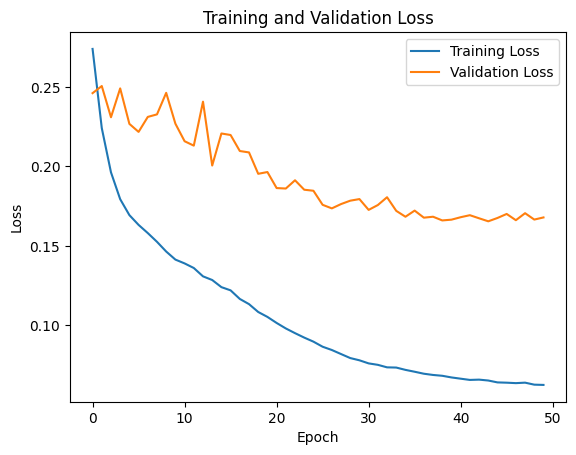

In [ ]:
# Plot the training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

1/1 [==============================] - 0s 228ms/step


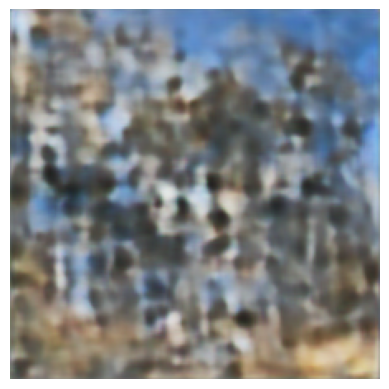

In [ ]:
import numpy as np

def generate_image(vae_decoder, latent_dim, z_sample=None):
    if z_sample is None:
        # Sample a random point from the latent space
        z_sample = np.random.normal(size=(1, latent_dim))

    # Generate an image using the decoder
    img = vae_decoder.predict(z_sample)

    # Scale from [-1, 1] to [0,1]
    img = (img + 1.) / 2.
    
    # Scale from [0, 1] to [0, 255]
    img = img * 255

    # Cast to uint8
    img = img.astype('uint8')

    return img
    
# Generate an image using the VAE decoder
vae_decoder = vae.get_layer('vae_decoder')
generated_image = generate_image(vae_decoder, latent_dim)

# Display the generated image
plt.imshow(generated_image[0])
plt.axis('off')
plt.show()

In [ ]:
from tensorflow.keras.preprocessing import image as image_utils

def encode_image(vae_encoder, img_path, input_shape):
    # Load and preprocess the image
    img = image_utils.load_img(img_path, target_size=input_shape[:2])
    img_array = image_utils.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)

    # Encode the image using the VAE encoder
    z_mean, z_log_var, z = vae_encoder.predict(img_array)
    
    return z_mean

# Encode an image using the VAE encoder
vae_encoder = vae.get_layer('vae_encoder')
latent_vector = encode_image(vae_encoder, img_path, input_shape)

# print("Latent vector:", latent_vector)

1/1 [==============================] - 1s 844ms/step


1/1 [==============================] - 0s 21ms/step


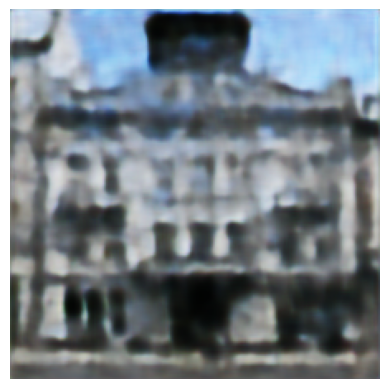

In [ ]:
generated_image = generate_image(vae_decoder, latent_dim, z_sample=latent_vector)

# Display the generated image
plt.imshow(generated_image[0])
plt.axis('off')
plt.show()

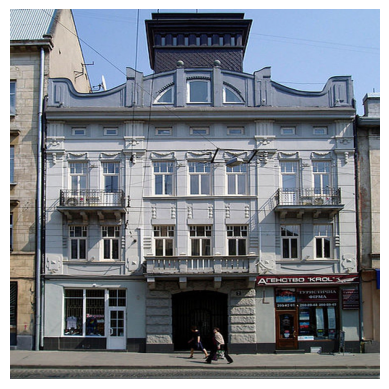

In [ ]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array

img = load_img(img_path, target_size=(512, 512))
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
#save the model 
# vae.save('vae_model_mobilenet.h5')


In [ ]:
!cp best_mobilenet_768_vae_model_epoch50.h5 '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/'

In [ ]:
!cp '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/best_mobilenet_768_vae_model.h5' /content/

In [ ]:
#load the model
from tensorflow.keras.models import load_model

# Register the Sampling layer's configuration
tf.keras.utils.get_custom_objects().update({'Sampling': Sampling})

# Load the VAE model
loaded_vae = load_model('best_mobilenet_768_vae_model.h5')

1/1 [==============================] - 0s 201ms/step


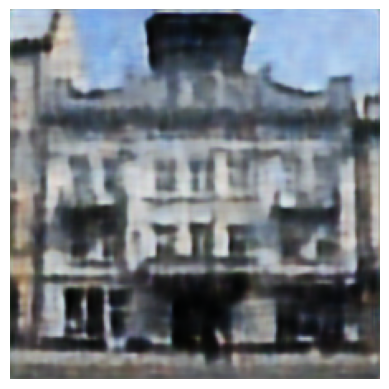

In [ ]:
# Encode an image using the VAE encoder
vae_encoder = loaded_vae.get_layer('vae_encoder')
# Generate an image using the VAE decoder
vae_decoder = loaded_vae.get_layer('vae_decoder')
latent_vector = encode_image(vae_encoder, img_path, input_shape)
generated_image = generate_image(vae_decoder, latent_dim, z_sample=latent_vector)

# Display the generated image
plt.imshow(generated_image[0])
plt.axis('off')
plt.show()

## Resnet50 based VAE

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.optimizers import Adam


In [ ]:
class Sampling(layers.Layer):
    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon


def build_vae_encoder(input_shape, latent_dim):
    resnet50 = ResNet50(include_top=False, weights='imagenet', input_shape=input_shape)
    x = resnet50.output

    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(512, activation='relu')(x)

    z_mean = layers.Dense(latent_dim, name='z_mean')(x)
    z_log_var = layers.Dense(latent_dim, name='z_log_var')(x)

    z = Sampling()([z_mean, z_log_var])

    encoder = Model(resnet50.input, [z_mean, z_log_var, z], name='vae_encoder')
    return encoder

def build_vae_decoder(input_shape, latent_dim):
    decoder_input = layers.Input(shape=(latent_dim,))
    x = layers.Dense(input_shape[0] // 4 * input_shape[1] // 4 * 64, activation='relu')(decoder_input)
    x = layers.Reshape((input_shape[0] // 4, input_shape[1] // 4, 64))(x)

    x = layers.Conv2DTranspose(128, kernel_size=3, activation='relu', strides=2, padding='same')(x)
    x = layers.Conv2DTranspose(64, kernel_size=3, activation='relu', strides=2, padding='same')(x)

    x = layers.Conv2D(input_shape[2], kernel_size=3, activation=None, padding='same')(x)  # Replace with Conv2D

    decoder_output = x
    decoder = Model(decoder_input, decoder_output, name='vae_decoder')
    return decoder

In [ ]:
def build_vae(input_shape, latent_dim):
    # Build the VAE encoder
    encoder = build_vae_encoder(input_shape, latent_dim)

    # Build the VAE decoder
    decoder = build_vae_decoder(input_shape, latent_dim)

    # Create the VAE model
    vae_input = layers.Input(shape=input_shape)
    z_mean, z_log_var, z = encoder(vae_input)
    vae_output = decoder(z)
    vae = Model(vae_input, vae_output, name='vae')

    # Add the KL divergence regularization loss
    kl_loss = -0.5 * tf.reduce_mean(z_log_var - tf.square(z_mean) - tf.exp(z_log_var) + 1)
    vae.add_loss(kl_loss * 0.0001)  #Adjust the weight of the KL loss with the multiplier

    return vae

In [ ]:
input_size = 256
train_generator, val_generator, test_generator = load_image_data(filename, path, img_height=input_size, img_width=input_size, class_modes = 'input')

3528
Found 2540 validated image filenames.
Found 635 validated image filenames.
Found 353 validated image filenames.


In [ ]:
input_shape = (input_size, input_size, 3)
latent_dim = 64*64
vae = build_vae(input_shape, latent_dim)

optimizer = Adam(learning_rate=1e-4)
vae.compile(optimizer=optimizer, loss=tf.keras.losses.MeanSquaredError())


In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

epochs = 100
batch_size = 8

# Set up the ModelCheckpoint callback
checkpoint_filepath = 'best_resnet_vae_model.h5'
checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_best_only=True,
    monitor='val_loss',
    mode='min',
    verbose=1
)

history = vae.fit(
    train_generator,
    epochs=epochs,
    batch_size=batch_size,
    validation_data=val_generator,
    callbacks=[checkpoint_callback]
)


Epoch 1/100
80/80 [==============================] - ETA: 0s - loss: 5012.4375
Epoch 1: val_loss improved from inf to 8207.48828, saving model to best_resnet_vae_model.h5
80/80 [==============================] - 711s 8s/step - loss: 5012.4375 - val_loss: 8207.4883
Epoch 2/100
80/80 [==============================] - ETA: 0s - loss: 4035.8831
Epoch 2: val_loss improved from 8207.48828 to 4371.12109, saving model to best_resnet_vae_model.h5
80/80 [==============================] - 78s 985ms/step - loss: 4035.8831 - val_loss: 4371.1211
Epoch 3/100
80/80 [==============================] - ETA: 0s - loss: 3939.5166
Epoch 3: val_loss improved from 4371.12109 to 3968.77368, saving model to best_resnet_vae_model.h5
80/80 [==============================] - 77s 963ms/step - loss: 3939.5166 - val_loss: 3968.7737
Epoch 4/100
80/80 [==============================] - ETA: 0s - loss: 3898.5239
Epoch 4: val_loss improved from 3968.77368 to 3927.92847, saving model to best_resnet_vae_model.h5
80/80 [==

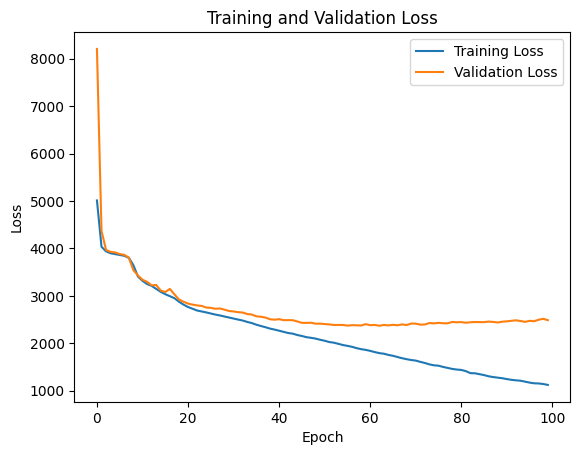

In [ ]:
# Plot the training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

1/1 [==============================] - 0s 287ms/step


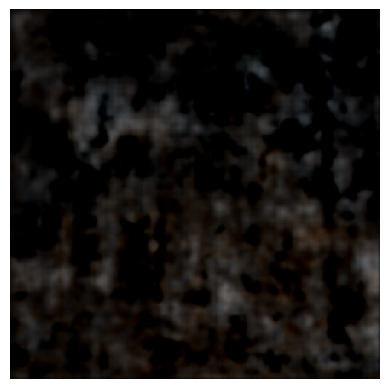

In [ ]:
import numpy as np

def generate_image(vae_decoder, latent_dim, z_sample = None):
    
    if z_sample is None:
      # Sample a random point from the latent space
      z_sample = np.random.normal(loc=0.0, scale=5.0, size=(1, latent_dim))

    # Generate an image using the decoder
    img = vae_decoder.predict(z_sample)

    # Clip and convert the image back to the original range (0-255)
    img = np.clip(img, 0, 255).astype('uint8')
    
    return img

# Generate an image using the VAE decoder
vae_decoder = vae.get_layer('vae_decoder')
generated_image = generate_image(vae_decoder, latent_dim)

# Display the generated image
plt.imshow(generated_image[0])
plt.axis('off')
plt.show()

In [ ]:
from tensorflow.keras.preprocessing import image as image_utils

def encode_image(vae_encoder, img_path, input_shape):
    # Load and preprocess the image
    img = image_utils.load_img(img_path, target_size=input_shape[:2])
    img_array = image_utils.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)

    # Encode the image using the VAE encoder
    z_mean, z_log_var, z = vae_encoder.predict(img_array)
    
    return z_mean

# Encode an image using the VAE encoder
vae_encoder = vae.get_layer('vae_encoder')
latent_vector = encode_image(vae_encoder, img_path, input_shape)

print("Latent vector:", latent_vector)

1/1 [==============================] - 1s 1s/step
Latent vector: [[-0.57028466  1.4105501   0.34217206 ... -0.05863414 -0.78155476
   1.3042231 ]]


1/1 [==============================] - 0s 21ms/step


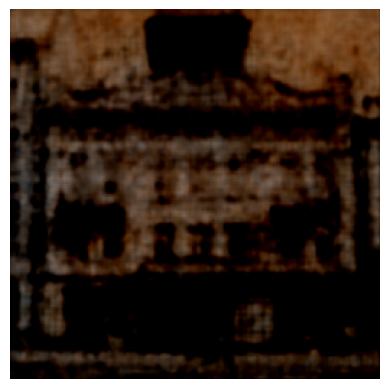

In [ ]:
generated_image = generate_image(vae_decoder, latent_dim, z_sample=latent_vector)

# Display the generated image
plt.imshow(generated_image[0])
plt.axis('off')
plt.show()

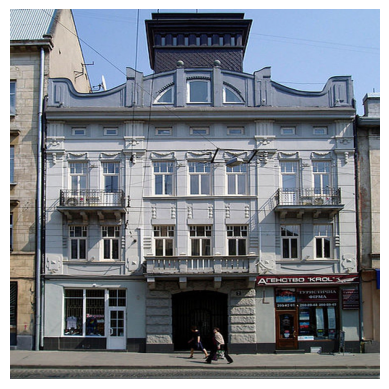

In [ ]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array

img = load_img(img_path, target_size=(512, 512))
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
#save the model 
vae.save('vae_model_mobilenet.h5')


In [ ]:
!cp best_resnet_vae_model.h5 '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/'

In [ ]:
#load the model
from tensorflow.keras.models import load_model

# Register the Sampling layer's configuration
tf.keras.utils.get_custom_objects().update({'Sampling': Sampling})

# Load the VAE model
loaded_vae = load_model('best_resnet_vae_model.h5')

1/1 [==============================] - 0s 91ms/step


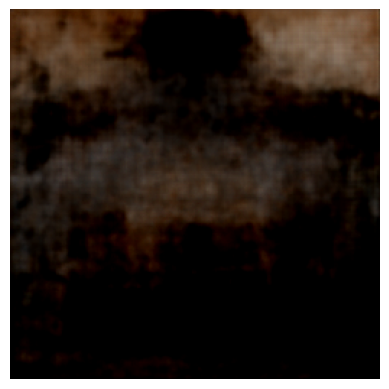

In [ ]:
# Encode an image using the VAE encoder
vae_encoder = loaded_vae.get_layer('vae_encoder')
# Generate an image using the VAE decoder
vae_decoder = loaded_vae.get_layer('vae_decoder')
latent_vector = encode_image(vae_encoder, img_path, input_shape)
generated_image = generate_image(vae_decoder, latent_dim, z_sample=latent_vector)

# Display the generated image
plt.imshow(generated_image[0])
plt.axis('off')
plt.show()

1/1 [==============================] - 0s 28ms/step


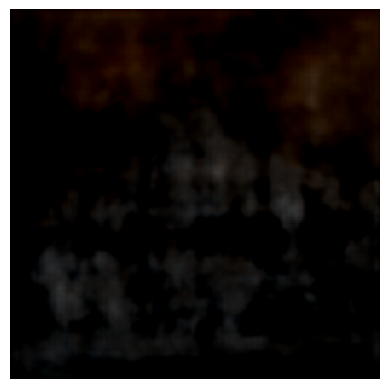

In [ ]:
# Generate an image using the VAE decoder
generated_image = generate_image(vae_decoder, latent_dim)

# Display the generated image
plt.imshow(generated_image[0])
plt.axis('off')
plt.show()

It seems that the resnet version kinda works, although it does not have the best result. It might be better to explore the data classified through this latent space latter using traditional techniques to see whether it can work.

#Discussion and Ideas

4/20 feedback from professor: there is no standard to measure the results. How could we have a benchmark to measure the experiment results?


**Key Question: how to measure the good or bad quality of the generated architecture style?**


Possible measurements: use the loss function. One thing is to think about cycleGan's loss. Or have a check on CLIP model. There might be a way to find the loss



## Loss

### DreamBooth's losss

DreamBooth uses fine tuning the model to fit the given pictures. It uses [token name] + [class noun] to achieve that. However there are overfitting problem and they created a class-specific prior-preservation loss so the model can differentiate the given pictures and the generated pictures form the model 

![](https://dreambooth.github.io/DreamBooth_files/system.png)


### CycleGAN's loss for the image style measurement

Cycle Consistency Loss: X, Y 2 generators. It ensures x--X-->y --Y--> x' so it min the x and x' loss

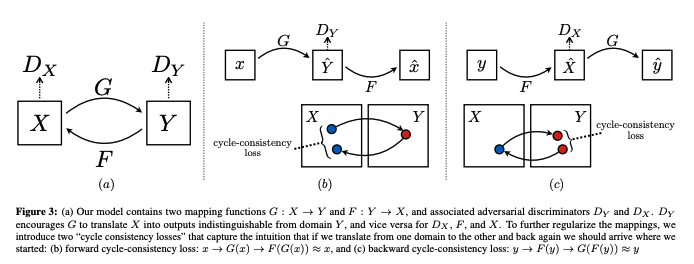

### Neural style loss

We implement a style loss into the stable diffusion. WE compute correlation between feature maps inorder to preserve style. This way we compare it with a realistic style architecture to obtain an output that is similar.

Referenced paper: [Neural Style Loss](https://arxiv.org/abs/1508.06576)


Maybe it is feasible to seperate out the style distribution from the stable diffusion? Use Gram matrix on the UNet of the stable diffusion to minmize the difference between feature distributions?

Since it is Unet we might use similar techniques on VGG -- find the feature distributions on the feature maps for each layer. But in this case input is text and output is image

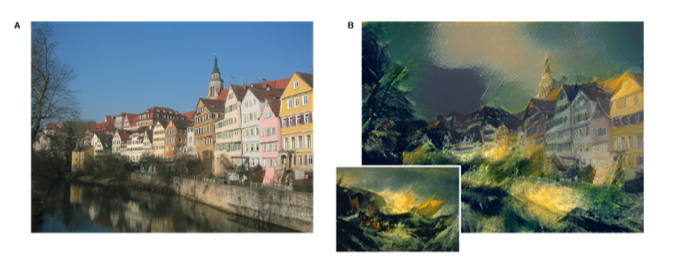

### Textual Inversion

Textual Inversion is the process of teaching an image generator a specific visual concept through the use of fine-tuning.

Minimizing the LDM loss over images sampled from the small set to find a new, learned embedding v∗. Using the v* as the condition so model is able to transfer style

It seems that the training part is small. Also able to modify only small part of the network. Fast training

![](https://textual-inversion.github.io/static/images/editing/colorful_teapot.JPG)

##Preliminary Conclusion

Maybe it is better to use the textual inversion type of the technique. Stable diffusion is trained on large enough dataset so it should learn the style. However, because textual input is difficult to control so we might be able to condition and compute the loss of the embedding of a new text. 

Combine the controlNet loss with textual inversion?
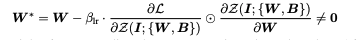

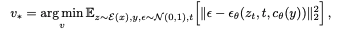




If the stable diffusion model already contains the required images, what we need to do is not to focus on retraining it. The model is large enough to contain the image style and base we need. The problem is how to pin down the 'style' embedding, or the latent space of 'style'. 

Textual inversion is to capture the 'style' through training on the embedding. DreamBooth is to finetune the model so the weights can learn the 'style' and additional embedding.

![](https://i.redd.it/vl01e5grs6ca1.png)

Another way is to train control net, but we change the condition to a textual embedding called style. It would be similar to hypernetworks

##Updated discussion on 4/25

We decided to use following approach. Train the control net but with the condition set as the text embeddding of style term, for example 'baroque_architecutre' as the condition. We expect this could learn the style.

Loss would be same as the stable diffusion:
![](https://miro.medium.com/v2/1*RtR_HiTQOMeSVhaehGT4yg.png)


The loss updates the gradient in the control net.

**Training**

![picture](https://drive.google.com/uc?id=1CZMR1Q2XvB6kRDwjekinEIS0XacORhAa)

**Final Model**

![picture](https://drive.google.com/uc?id=1nuVuVjQImCfUGmtZ4dCtfgKotb-IODaP)

##Task Break Down:


1.   Data Cleaning/Checking/Data Exploration(Bilal)
*   Data exploration
*   Data Cleaning as pipeline required


2.   ControlNet model modification (Qi)
3.   Training Pipeline
4.   Concat control net for scribble drawings
https://github.com/huggingface/diffusers/issues/2556
Have a check on this


5.   Model Pipeline

##5/1 Discussion

Decided to use a style classifer network on top. In this case, we can have a more clear loss function to express different styles. Also we can explore the feature layers. In this case we can have automatic extraction of relevant features for the style as input. 

Probably gonna use VGG/ResNet type of CNN based architecture for the feature extraction

##5/11 Feedback

It would be better to adda classifier and use it to gather quantantitive results for the image generation.

Tasks Needs to be done:

1.   Data Checking/Data Exploration(Bilal)
*   Data exploration
*   Data Cleaning as pipeline required
*   Data prepreation should be put into the datasets format for hugging face. It should follow: [Huggingface Data Folder prepare](https://huggingface.co/docs/datasets/image_dataset#loading-script). The Folder result should reference with following. There should be another column for the "conditioning_latents". Using autoencoder loaded with 'best_mobilenet_768_vae_model' in shared google folder to proceed that. Please reference to MobileNet based VAE section





Data Preprocessing

Need to preprocess the data into desired format of the hugging face dataset:
image, conditioning_imag, text

The reference should consider from this link:
https://huggingface.co/datasets/fusing/fill50k

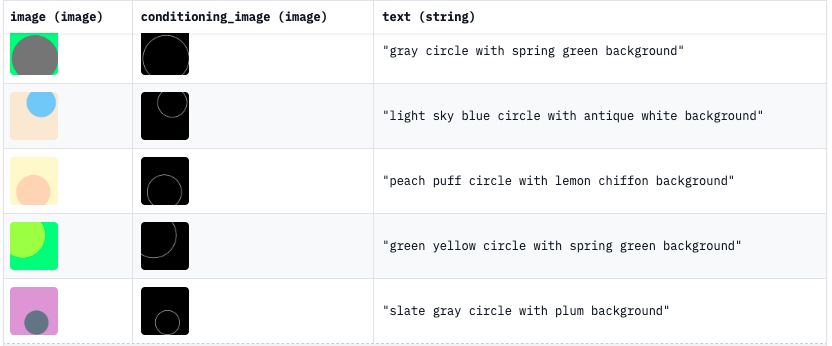




2.   ControlNet model modification (Qi)
3.   Training Pipeline
4.   Concat control net for scribble drawings
https://github.com/huggingface/diffusers/issues/2556
Have a check on this


5.   Model Pipeline

6. Need a classifier from latent representation to see how well we do

Need to discuss the data cleaning (regression, etc)

Use existing lib is it okay

#Data preprocessing

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from PIL import Image
import os


  

# resize_ratio = 0.5  # where 0.5 is half size, 2 is double size

def resize_aspect_fit(path,item):
    dirs = os.listdir(path+'/'+item)
    path2 = path+"_resize/"+item+"/"
    path=path+"/"+item+"/"
    if not os.path.exists(path2):
      os.makedirs(path2)
    for item in dirs:
       
        if os.path.isfile(path+item):
            file_path, extension = os.path.splitext(path+item)
            # print(extension)
            if extension != '.jpg':
                continue
            image = Image.open(path+item)
            file_path, extension = os.path.splitext(path+item)

            new_image_height = 512
            new_image_length = 512

            image = image.resize((new_image_height, new_image_length), Image.ANTIALIAS)
            # image.thumbnail((new_image_height, new_image_length), Image.ANTIALIAS)
            image.save(path2 +item, 'JPEG', quality=100)

path = "drive/MyDrive/arcDataset"
dirs = os.listdir(path)
for item in dirs:
  if os.path.isdir(path+'/'+item):
    resize_aspect_fit(path,item)

In [ ]:
!git clone https://github.com/lllyasviel/ControlNet.git

Cloning into 'ControlNet'...
remote: Enumerating objects: 1350, done.
remote: Counting objects: 100% (1350/1350), done.
remote: Compressing objects: 100% (739/739), done.
remote: Total 1350 (delta 614), reused 1292 (delta 588), pack-reused 0
Receiving objects: 100% (1350/1350), 122.37 MiB | 19.14 MiB/s, done.
Resolving deltas: 100% (614/614), done.


In [ ]:
!pip install einops
!pip install basicsr

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 3.6 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.5/172.5 kB 10.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.2/299.2 kB 34.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 36.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.9/200.9 kB 24.2 MB/s eta 0:00:00
  Created wheel for basicsr: filename=basicsr-1.4.2-py3-none-any.whl size=214838 sha256=9129eecc9309eb30ea87e0769ec7efce1954c72a6c4ba41880136027d2d65efa
  Stored in directory: /root/.cache/pip/wheels/38/83/99/2d8437cc652a01af27df5ff037a4075e95b52d67705c5f30ca
Successfully built basicsr


In [ ]:
import os
from PIL import Image
import numpy as np
# os.chdir('/ControlNet')
from annotator.mlsd import MLSDdetector
import torch
from annotator.util import resize_image, HWC3
apply_hed = MLSDdetector()
path = "/content/drive/MyDrive/arcDataset_resize/Art Deco architecture/1059_800px-PAST_Lodz.jpg"
with torch.no_grad():
        input_image = Image.open(path)
        input_image = np.array(input_image)
        input_image = HWC3(input_image)
        detected_map = apply_hed(input_image,0.1,0.1)

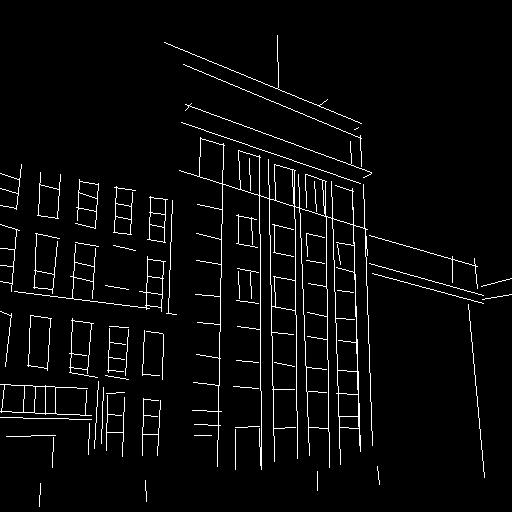

In [ ]:
from google.colab.patches import cv2_imshow
# img = cv2.imread('logo.png', cv2.IMREAD_UNCHANGED)
cv2_imshow(detected_map)

In [ ]:
import cv2
cv2.imwrite('test.png',detected_map )

True

In [ ]:
from PIL import Image
import os

def create_hough(path,item):
    dirs = os.listdir(path+'/'+item)
    path2 = path+"_hough/"+item+"/"
    path=path+"/"+item+"/"
    if not os.path.exists(path2):
      os.makedirs(path2)
    for item in dirs:
       
        if os.path.isfile(path+item):
            file_path, extension = os.path.splitext(path+item)
            # print(extension)
            if extension != '.jpg':
                continue
            with torch.no_grad():
              input_image = Image.open(path+item)
              input_image = np.array(input_image)
              input_image = HWC3(input_image)
              detected_map = apply_hed(input_image,0.1,0.1)
            cv2.imwrite(path2+item[:-4]+'.png',detected_map )
path = "/content/drive/MyDrive/arcDataset_resize"
dirs = os.listdir(path)
for item in dirs:
  if os.path.isdir(path+'/'+item):
    create_hough(path,item)

In [ ]:
import os
path = "/content/drive/MyDrive/arcDataset_resize"
dirs = os.listdir(path)
labels= {k: v for v, k in enumerate(dirs)}
labels

{'International style': 0,
 'Ancient Egyptian architecture': 1,
 'Tudor Revival architecture': 2,
 'Colonial architecture': 3,
 'Palladian architecture': 4,
 'Chicago school architecture': 5,
 'Beaux-Arts architecture': 6,
 'Gothic architecture': 7,
 'Romanesque architecture': 8,
 'Novelty architecture': 9,
 'Queen Anne architecture': 10,
 'Edwardian architecture': 11,
 'Bauhaus architecture': 12,
 'American craftsman style': 13,
 'Georgian architecture': 14,
 'Greek Revival architecture': 15,
 'Deconstructivism': 16,
 'Art Nouveau architecture': 17,
 'Baroque architecture': 18,
 'arcDataset': 19,
 'Byzantine architecture': 20,
 'Russian Revival architecture': 21,
 'Postmodern architecture': 22,
 'American Foursquare architecture': 23,
 'Achaemenid architecture': 24,
 'Art Deco architecture': 25,
 '.ipynb_checkpoints': 26}

In [ ]:
from PIL import Image
import os
def create_labels(path,item):
    dirs = os.listdir(path+'/'+item)
    path2 = path+"_hough/"+item+"/"
    path=path+"/"+item+"/"
    if not os.path.exists(path2):
      os.makedirs(path2)
    for item in dirs:
       
        if os.path.isfile(path+item):
            file_path, extension = os.path.splitext(path+item)
            # print(extension)
            if extension != '.jpg':
                continue
            with torch.no_grad():
              input_image = Image.open(path+item)
              input_image = np.array(input_image)
              input_image = HWC3(input_image)
              detected_map = apply_hed(input_image,0.1,0.1)
            cv2.imwrite(path2+item[:-4]+'.png',detected_map )
path = "/content/drive/MyDrive/arcDataset_resize"
dirs = os.listdir(path)
for item in dirs:
  if os.path.isdir(path+'/'+item):
    create_hough(path,item)

In [ ]:
!pip install urllib3

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
path = "/content/drive/MyDrive/arcDataset_resize"
dirs = os.listdir(path)
import re
import urllib.parse

def clean_file_name(file_name):

    # Remove numbers at the beginning of the file name
    file_name = re.sub(r"^\d+_", "", file_name)
    # Remove the file extension
    file_name = file_name.split('.')[0]
    
    # Replace underscores with spaces
    file_name = re.sub(r"[_-]", " ", file_name)
    
    # Remove numbers at the beginning of the string
    file_name = re.sub(r'^\d+_', '', file_name)
    
    # Remove numbers and "px" in the middle of the string
    file_name = re.sub(r'\d+px', '', file_name)
    
    # Remove percent encoding
    file_name = urllib.parse.unquote(file_name)

    file_name = re.sub(r'\d+|[()]|[-]', '', file_name).strip()
    
    # Extract the relevant portion of the file name and remove unwanted text
    match = re.search(r'^(.*?)San\s*Diego', file_name)
    if match:
        file_name = match.group(1) + 'San Diego'
    
    # Capitalize the first letter of each word
    file_name = file_name.title()
    
    return file_name
out_csv=[['filename','text_prompt','label']]
for item in dirs:
  path = "/content/drive/MyDrive/arcDataset_resize"
  if os.path.isdir(path+'/'+item):
    path=path+"/"+item+"/"
    dirs2 = os.listdir(path)


    for file_name in dirs2:

        building_name=clean_file_name(file_name)
        out_csv.append([item+'/'+file_name,building_name,labels[item]])



In [ ]:
out_csv[:5]

[['filename', 'text_prompt', 'label'],
 ['International style/1459_437px-PSFSsign.jpg', 'Psfssign', 0],
 ['International style/1140_Beit_polishuk.jpg', 'Beit Polishuk', 0],
 ['International style/1414_Compass_Bank_Albuquerque.jpg',
  'Compass Bank Albuquerque',
  0],
 ['International style/1366_579px-425_Market_Street%2C_San_Francisco.jpg',
  'Market Street, San Francisco',
  0]]

In [ ]:
import csv

with open("/content/drive/MyDrive/labels.csv", "w" ,newline="") as f:
    writer = csv.writer(f)
    writer.writerows(out_csv)

##Load Encoder and process image to latent space

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
import os
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras import layers, Model
# from tensorflow.keras.applications import ResNet50
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.callbacks import ModelCheckpoint
#load the model
from tensorflow.keras.models import load_model

from tensorflow.keras.preprocessing import image as image_utils
from pathlib import Path


In [ ]:
#Change Here ******** Change the projectPath to the project folder ******** /yourpathtoproject/Project
projectPath = '/content/drive/MyDrive/Project'

In [ ]:
modelPath = 'best_mobilenet_768_vae_model.h5'

joinedPath = Path(os.path.join(projectPath, modelPath))
print(Path(joinedPath))


/content/drive/MyDrive/Project/best_mobilenet_768_vae_model.h5


In [ ]:
!cp '/content/drive/MyDrive/Project/best_mobilenet_768_vae_model.h5' /content/

In [ ]:
filename = 'labels_refined.csv'
filename = Path(os.path.join(projectPath, filename))
datapath = 'Data/arcDataset_resize/'
datapath = Path(os.path.join(projectPath, datapath))

df = pd.read_csv(filename)
img_path = os.path.join(datapath, df['filename'][0])
print(img_path)

/content/drive/MyDrive/Project/Data/arcDataset_resize/Art Nouveau architecture/4728_450px-7%2C_Franka_Street%2C_Lviv.jpg


In [ ]:
class Sampling(layers.Layer):
    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon


def generate_image(vae_decoder, latent_dim, z_sample=None):
    if z_sample is None:
        # Sample a random point from the latent space
        z_sample = np.random.normal(size=(1, latent_dim))

    # Generate an image using the decoder
    img = vae_decoder.predict(z_sample)

    # Scale from [-1, 1] to [0,1]
    img = (img + 1.) / 2.
    
    # Scale from [0, 1] to [0, 255]
    img = img * 255

    # Cast to uint8
    img = img.astype('uint8')

    return img


def encode_image(vae_encoder, img_path, input_shape):
    # Load and preprocess the image
    img = image_utils.load_img(img_path, target_size=input_shape[:2])
    img_array = image_utils.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)

    # Encode the image using the VAE encoder
    z_mean, z_log_var, z = vae_encoder.predict(img_array)
    
    return z_mean

In [ ]:

# Register the Sampling layer's configuration
tf.keras.utils.get_custom_objects().update({'Sampling': Sampling})

# Load the VAE model
loaded_vae = load_model('best_mobilenet_768_vae_model.h5')

In [ ]:
input_shape = (224, 224, 3)
latent_dim = 768


# Generate an image using the VAE decoder
vae_decoder = loaded_vae.get_layer('vae_decoder')

# Encode an image using the VAE encoder
vae_encoder = loaded_vae.get_layer('vae_encoder')

In [ ]:
#key function to use in order to get the latent vector
latent_vector = encode_image(vae_encoder, img_path, input_shape)


1/1 [==============================] - 11s 11s/step


1/1 [==============================] - 2s 2s/step


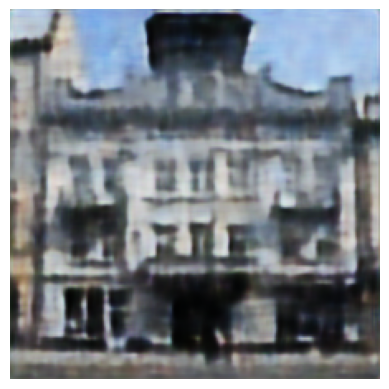

In [ ]:
#decode the latent vector and generte image
generated_image = generate_image(vae_decoder, latent_dim, z_sample=latent_vector)

# Display the generated image
plt.imshow(generated_image[0])
plt.axis('off')
plt.show()

In [ ]:
filename = 'labels_refined.csv'
filename = Path(os.path.join(projectPath, filename))
datapath = 'Data/arcDataset_resize/'
datapath = Path(os.path.join(projectPath, datapath))
dest='/content/drive/MyDrive/Project/arcDatasetCombined/data/arcDataset_resize_latent/'
df = pd.read_csv(filename)
path = "drive/MyDrive/arcDataset"
dirs = os.listdir(path)
for item in dirs:
  if not os.path.exists(dest+item):
      os.makedirs(dest+item)

for x,f in enumerate(df['filename']):
  img_path = os.path.join(datapath, f)
  latent_vector = encode_image(vae_encoder, img_path, input_shape)
  # print(latent_vector.shape)
  outer=np.tile(latent_vector, (77, 1))
  np.save(dest+f[:-4]+'.npy', outer)

1/1 [==============================] - 0s 38ms/step


In [ ]:
!pip install datasets==2.9.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 462.8/462.8 kB 39.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 18.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 32.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.3/134.3 kB 20.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 76.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 33.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 18.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 36.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.6/149.6 kB 24.0 MB/s eta 0:00:00


In [ ]:
import os
import pandas as pd
from PIL import Image
import numpy as np
import datasets
from datasets import Dataset, GeneratorBasedBuilder
from typing import Tuple
import csv
import json

class AIDA_dataset(GeneratorBasedBuilder):
    """AIDA Images dataset"""

    VERSION = '1.0.0'

    def __init__(self, data_dir, **kwargs):
        """BuilderConfig for Food-101.
        Args:
          data_url: `string`, url to download the zip file from.
          metadata_urls: dictionary with keys 'train' and 'validation' containing the archive metadata URLs
          **kwargs: keyword arguments forwarded to super.
        """
        super(AIDA_dataset, self)
        # .__init__(version=datasets.Version("1.0.0"), **kwargs)
        self.data_dir = data_dir

    def _info(self):
        features = {
            'image': datasets.features.Image(),
            'outline': datasets.features.Image(),
            'latent': datasets.features.Array(shape=(77,768), dtype=np.float32),
            'text_prompt': datasets.features.ClassLabel(names_file='classes.txt')
        }
        return datasets.DatasetInfo(
            features=datasets.Features(features),
            description='AIDA dataset'
        )

    def _split_generators(self, dl_manager):
        images_path = os.path.join(self.data_dir, 'arcDataset_resize')
        outline = os.path.join(self.data_dir, 'arcDataset_resize_hough')
        latent = os.path.join(self.data_dir, 'arcDataset_resize_latent')
        csv_file = os.path.join(self.data_dir, 'labels_refined.csv')
        classes_file = os.path.join(self.data_dir, 'labels_refined.csv')

        data = pd.read_csv(csv_file)
        train_data = data.sample(frac=0.8, random_state=42)
        test_data = data.drop(train_data.index)

        train_csv = os.path.join(self.config.data_dir, 'train.csv')
        train_data.to_csv(train_csv, index=False)

        test_csv = os.path.join(self.config.data_dir, 'test.csv')
        test_data.to_csv(test_csv, index=False)

        return [
            datasets.SplitGenerator(name=datasets.Split.TRAIN, gen_kwargs={'images_path': images_path, 'outline_path': outline, 'latent_path': latent, 'csv_file': train_csv, 'classes_file': classes_file}),
            datasets.SplitGenerator(name=datasets.Split.TEST, gen_kwargs={'images_path': images_path, 'outline_path': outline, 'latent_path': latent, 'csv_file': test_csv, 'classes_file': classes_file})
        ]

    def _generate_examples(self, images_path, outline_path, latent_path, csv_file, classes_file):
        data = pd.read_csv(csv_file)
        classes = [line.rstrip('\n') for line in open(classes_file)]

        for index, row in data.iterrows():
            image_path = os.path.join(images_path, row['filename'])
            outline_path1 = os.path.join(outline_path, row['filename'])
            latent_path1 = os.path.join(latent_path, row['filename'])
            text_prompt = classes.index(row['text_prompt'])
            with open(image_path, 'rb') as f1, open(outline_path1, 'rb') as f2:
                image = Image.open(f1).convert('RGB')
                outline = Image.open(f2).convert('RGB')
            latent = np.load(latent_path1)

            yield index, {
                'image': image,
                'outline': outline,
                'latent':latent,
                'text_prompt': text_prompt
            }


In [ ]:
import os
import pandas as pd
from PIL import Image
import numpy as np
import datasets
from datasets import Dataset, GeneratorBasedBuilder
from typing import Tuple
import csv
from pathlib import Path
import json

class AIDA_dataset(GeneratorBasedBuilder):
    """AIDA Images dataset"""

    VERSION = '1.0.0'

    
    BUILDER_CONFIGS = [
        datasets.BuilderConfig(name="config1", version="1.0.0", description="Config 1"),
        datasets.BuilderConfig(name="config2", version="1.0.0", description="Config 2")
    ]
    
    def __init__(self, config=None, **kwargs):
        super().__init__(**kwargs)
        self.config = config

    def _info(self):
        features = {
            'image': datasets.features.Image(),
            'outline': datasets.features.Image(),
            'latent': datasets.Sequence(datasets.Value("float32")),
            'text_prompt':  datasets.Value("string")
        }
        return datasets.DatasetInfo(
            features=datasets.Features(features),
            description='AIDA dataset'
        )

    def _split_generators(self, dl_manager):
        data_dir = Path("/content/drive/MyDrive/Project")
        images_path = os.path.join('/content/drive/MyDrive/Project', 'arcDataset_resize')
        outline = os.path.join('/content/drive/MyDrive/Project', 'arcDataset_resize_hough')
        latent = os.path.join('/content/drive/MyDrive/Project', 'arcDataset_resize_latent')
        csv_file = os.path.join('/content/drive/MyDrive/Project', 'labels_refined.csv')
        classes_file = os.path.join('/content/drive/MyDrive/Project', 'labels_refined.csv')

        data = pd.read_csv(csv_file)
        train_data = data.sample(frac=0.8, random_state=42)
        test_data = data.drop(train_data.index)

        train_csv = os.path.join(self.config.data_dir, 'train.csv')
        train_data.to_csv(train_csv, index=False)

        test_csv = os.path.join(self.config.data_dir, 'test.csv')
        test_data.to_csv(test_csv, index=False)

        return [
            datasets.SplitGenerator(name=datasets.Split.TRAIN, gen_kwargs={'images_path': images_path, 'outline_path': outline, 'latent_path': latent, 'csv_file': train_csv, 'classes_file': classes_file}),
            datasets.SplitGenerator(name=datasets.Split.TEST, gen_kwargs={'images_path': images_path, 'outline_path': outline, 'latent_path': latent, 'csv_file': test_csv, 'classes_file': classes_file})
        ]

    def _generate_examples(self, images_path, outline_path, latent_path, csv_file, classes_file):
        data = pd.read_csv(csv_file)
        classes = [line.rstrip('\n') for line in open(classes_file)]

        for index, row in data.iterrows():
            try:
              image_path = os.path.join(images_path, row['filename'])
              outline_path1 = os.path.join(outline_path, row['filename'])
              latent_path1 = os.path.join(latent_path, row['filename'])
              text_prompt =row['text_prompt']
              with open(image_path, 'rb') as f1, open(outline_path1, 'rb') as f2:
                  image = Image.open(f1).convert('RGB')
                  outline = Image.open(f2).convert('RGB')
              latent = np.load(latent_path1)

              yield index, {
                  'image': image,
                  'outline': outline,
                  'latent':latent,
                  'text_prompt': text_prompt
              }
            except:
              continue


In [ ]:
dd=AIDA_dataset('/content/drive/MyDrive/Project')

TypeError: ignored

In [ ]:
from datasets import load_dataset
dataset = load_dataset("/content/drive/MyDrive/Project/Project.py")

ValueError: ignored

In [ ]:
from datasets import DatasetDict, load_dataset
from pathlib import Path
import datasets
import numpy as np


data_dir = Path("/content/drive/MyDrive/Project/")
config = datasets.BuilderConfig(data_dir=data_dir)
dataset = load_dataset("/content/drive/MyDrive/Project/", 'config1', config=config)


Generating train split: 0 examples [00:00, ? examples/s]

[Errno 2] No such file or directory: '/content/drive/MyDrive/Project/arcDatasetCombined/data/arcDataset_resize_hough/Romanesque architecture/5219_800px-BiescasBardaixi-StSadurni-3187sh.png'
[Errno 2] No such file or directory: '/content/drive/MyDrive/Project/arcDatasetCombined/data/arcDataset_resize_hough/Deconstructivism/2661_lossy-page1-800px-Seattle_Music_Project_by_architect_Frank_O._Gehry%2C_Seattle%2C_Washington_-_photo_by_Carol_M_Highsmith_-_loc_04500u.tif.png'


KeyboardInterrupt: ignored

In [ ]:
dataset.save_to_disk("/content/drive/MyDrive/Project/arcDatasetCombined/hf_data")

Saving the dataset (0/3 shards):   0%|          | 0/2784 [00:00<?, ? examples/s]

ArrowNotImplementedError: ignored

In [ ]:
dataset['train']['latent'][0]

#Stable Diffusion Training

The training is going to use hugging face diffuser. 

https://github.com/huggingface/diffusers/tree/main/examples/controlnet



## Install `wandb` library and login


Start by installing the library and logging in to your free account.



In [ ]:
!pip install wandb -qU

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 75.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 25.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 205.1/205.1 kB 25.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 9.1 MB/s eta 0:00:00


In [ ]:
# Log in to your W&B account
import wandb

In [ ]:
wandb.login(key="732984f242e695cf93de19d10bd81f5fda59817a")

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

## Import Library

In [ ]:
# import shutil
# shutil.rmtree('/content/diffusers', ignore_errors=True)

In [ ]:
!git clone https://github.com/user074/diffusers


Cloning into 'diffusers'...
remote: Enumerating objects: 22043, done.
remote: Counting objects: 100% (34/34), done.
remote: Compressing objects: 100% (14/14), done.
remote: Total 22043 (delta 18), reused 27 (delta 17), pack-reused 22009
Receiving objects: 100% (22043/22043), 16.07 MiB | 14.30 MiB/s, done.
Resolving deltas: 100% (16049/16049), done.


In [ ]:
%cd diffusers

/content/diffusers


In [ ]:
!pip install -f -e /content/diffusers/ diffusers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: -e
Processing /content/diffusers
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 25.9 MB/s eta 0:00:00
  Created wheel for diffusers: filename=diffusers-0.17.0.dev0-py3-none-any.whl size=965939 sha256=6efee2e9de1adb9b17a81541739ef57421237b31a0f91c71a1f81e0c1958ec0d
  Stored in directory: /tmp/pip-ephem-wheel-cache-f3c2r0jp/wheels/95/c5/3b/e1b4269f8a2584de57e75f949a185b48fc4144e9a91fc9965a
Successfully built diffusers


In [ ]:
!pip install -r /content/diffusers/examples/controlnet/requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 219.1/219.1 kB 20.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 90.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 474.6/474.6 kB 49.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 126.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 17.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 26.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.3/134.3 kB 19.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 74.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 15.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 26.5 MB/s eta 0:00:00
     ━━━━━━━━━━━

In [ ]:
from accelerate.utils import write_basic_config
write_basic_config()

PosixPath('/root/.cache/huggingface/accelerate/default_config.yaml')

##Load Data

In [ ]:
!cp '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/arcDatasetCombined.zip' /content/

In [ ]:
!unzip /content/arcDatasetCombined.zip

Streaming output truncated to the last 5000 lines.
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/1137_800px-Park_Avenue_2C_405-407_2C_Feltus_Duplex_2C_University_Courts.jpg  
  inflating: __MACOSX/arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/._1137_800px-Park_Avenue_2C_405-407_2C_Feltus_Duplex_2C_University_Courts.jpg  
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/1229_800px-Jordan_Avenue_South_2C_530_2C_Elm_Heights_HD.jpg  
  inflating: __MACOSX/arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/._1229_800px-Jordan_Avenue_South_2C_530_2C_Elm_Heights_HD.jpg  
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/1503_450px-Liberty_London_20.jpg  
  inflating: __MACOSX/arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/._1503_450px-Liberty_London_20.jpg  
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival archi

In [ ]:
import datasets
from datasets import DatasetDict, load_dataset
from pathlib import Path
import datasets
import numpy as np


data_dir = Path("/content/diffusers/arcDatasetCombined/")
config = datasets.BuilderConfig(data_dir=data_dir)
dataset = load_dataset("/content/diffusers/arcDatasetCombined/")


Generating train split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset arc_dataset_combined downloaded and prepared to /root/.cache/huggingface/datasets/arc_dataset_combined/default/1.0.0/ed6d643397a73a4f9354a1a5609d4cf50e5b4eae068f0cb297c431d5ef41be21. Subsequent calls will reuse this data.


  0%|          | 0/2 [00:00<?, ?it/s]

In [ ]:
dataset

DatasetDict({
    train: Dataset({
        features: ['image', 'conditioning_image', 'latent', 'text'],
        num_rows: 1963
    })
    test: Dataset({
        features: ['image', 'conditioning_image', 'latent', 'text'],
        num_rows: 479
    })
})

In [ ]:
dataset['test']['conditioning_image'][0].save("test.png")

## Training

In [ ]:
prompt = dataset['test']['text'][0]
control_image = dataset['test']['conditioning_image'][0]
condition_latent = dataset['test']['latent'][0]

In [ ]:
x=torch.tensor(condition_latent[0])
x=x.repeat(77,1) 
x=x.unsqueeze(0)
print(x.shape)

torch.Size([1, 77, 768])


In [ ]:
MODEL_DIR="runwayml/stable-diffusion-v1-5"
OUTPUT_DIR="/content/"
Controlnet_diir = "lllyasviel/control_v11p_sd15_mlsd"
# !export OUTPUT_DIR="runs/fill-circle-{timestamp}"
# !export HUB_MODEL_ID="controlnet-fill-circle"

In [ ]:
!accelerate launch /content/diffusers/examples/controlnet/train_controlnet_latent.py \
 --pretrained_model_name_or_path={MODEL_DIR} \
 --controlnet_model_name_or_path={Controlnet_diir} \
 --output_dir={OUTPUT_DIR} \
 --num_train_epochs=5 \
 --dataset_name './arcDatasetCombined' \
 --resolution=512 \
 --learning_rate=1e-5 \
 --validation_image "./test.png"  \
 --validation_prompt prompt \
 --validation_condition_latent condition_latent \
 --train_batch_size=1 \
 --tracker_project_name="controlnet-5epoch" \
 --report_to="wandb" \
 --gradient_accumulation_steps=4


2023-05-16 21:49:05.102592: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2023-05-16 21:49:09.873158: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:258: FutureWarning: `logging_dir` is deprecated and will be removed in version 0.18.0 of 🤗 Accelerate. Use `project_dir` instead.
  warnings.warn(
05/16/2023 21:49:12 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'dynamic_thresholding_ratio', 'variance_type', 'clip_sample_range', 'sample_max_value', 'prediction_type', 'thresholding'} was not found in config. Values will be initialized to default values.
{'scaling_factor'} was 

Probably need to modify validation_prompt arugument to take encoder in

also need to modify the StableDiffusionControlNetPipeline to perform inference

##Save Model

In [ ]:
!cp /content/config.json '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/model2'

In [ ]:
!cp /content/diffusion_pytorch_model.bin '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/model2'

In [ ]:
!cp -r /content/checkpoint-500 '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/'

In [ ]:
!cp -r /content/checkpoint-1000 '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/'

In [ ]:
!cp -r /content/checkpoint-1500 '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/'

In [ ]:
!cp -r /content/checkpoint-2000 '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/'

## Model Pipeline for Inference

In [ ]:
!cp -r '/content/drive/MyDrive/Colab Notebooks/DNNTFclass/Project/model' /content/

In [ ]:
# import diffusers
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, UniPCMultistepScheduler
from diffusers.utils import load_image
import torch

In [ ]:
base_model_path = "runwayml/stable-diffusion-v1-5"
controlnet_path = "/content/model"

In [ ]:
controlnet = ControlNetModel.from_pretrained(controlnet_path, torch_dtype=torch.float16)
pipe = StableDiffusionControlNetPipeline.from_pretrained(
    base_model_path, controlnet=controlnet, torch_dtype=torch.float16
)

# speed up diffusion process with faster scheduler and memory optimization
pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)
pipe.enable_model_cpu_offload()

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


In [ ]:
dataset['test']

Dataset({
    features: ['image', 'conditioning_image', 'latent', 'text'],
    num_rows: 479
})

In [ ]:
prompt = dataset['test']['text'][0]
control_image = dataset['test']['conditioning_image'][0]
condition_latent = dataset['test']['latent'][0]

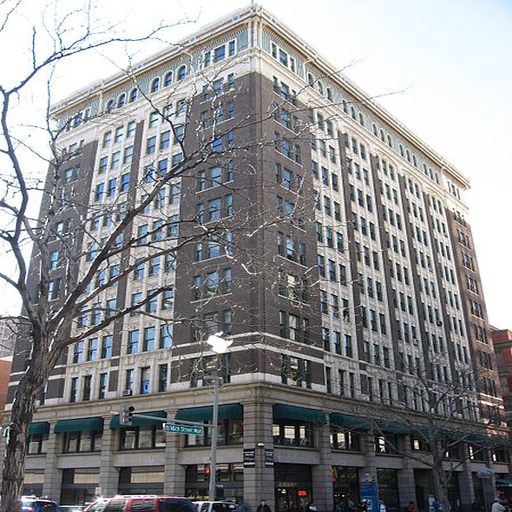

In [ ]:
dataset['test']['image'][0]

In [ ]:
prompt

'A.C. Foster Building'

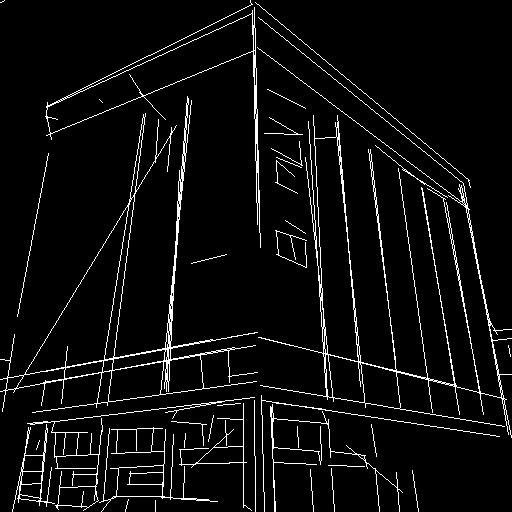

In [ ]:
control_image = load_image("./test.png")
control_image

In [ ]:
#Expand the latent dimension from 768 to 77*768 to match the size of the encoder_hidden_states
def expand_latent(latent):
    latent_tensor = torch.tensor(latent)
    latent_tensor = latent_tensor.unsqueeze(0)
    return latent_tensor

In [ ]:
condition_latent = expand_latent(dataset['test']['latent'][0])


In [ ]:
# generate image
generator = torch.manual_seed(0)
image = pipe(
     prompt, num_inference_steps=20, generator=generator, image=control_image,  conditioning_latent = condition_latent
).images[0]



  0%|          | 0/20 [00:00<?, ?it/s]

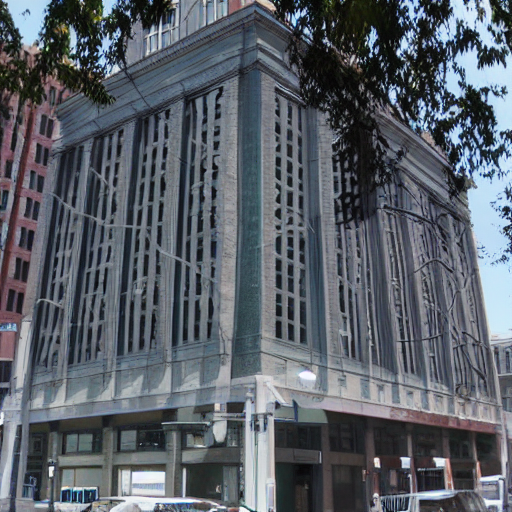

In [ ]:
image

Another Image

Ahlf House   Grants Pass Oregon


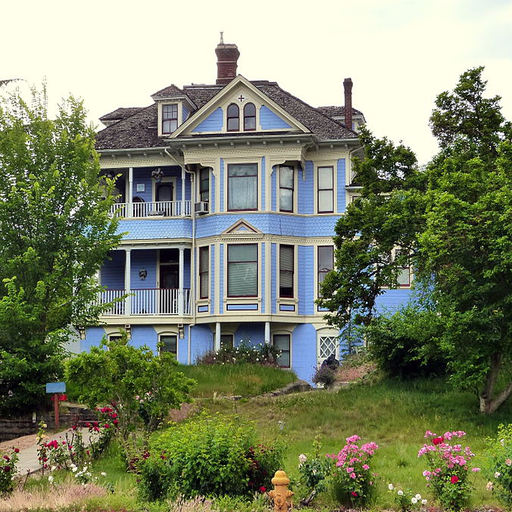

In [ ]:
img_num = 3
prompt = dataset['test']['text'][img_num]
print(prompt)
condition_latent = dataset['test']['latent'][img_num]
dataset['test']['image'][img_num]

<ipython-input-57-049daaa85386>:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  latent_tensor = torch.tensor(latent)


  0%|          | 0/20 [00:00<?, ?it/s]

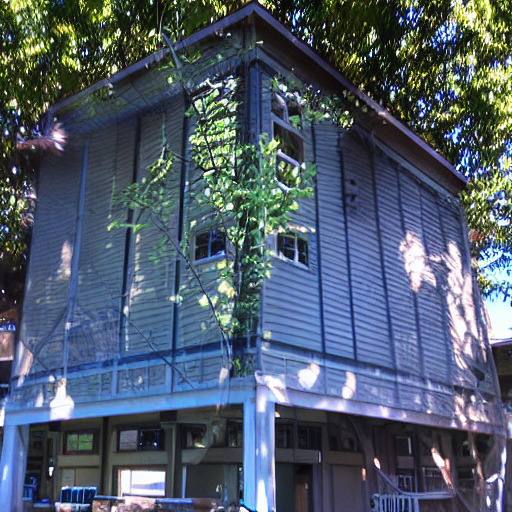

In [ ]:
condition_latent = torch.tensor(dataset['test']['latent'][img_num])
condition_latent = expand_latent(condition_latent)

# generate image
generator = torch.manual_seed(0)
image = pipe(
     prompt, num_inference_steps=20, generator=generator, image=control_image,  conditioning_latent = condition_latent
).images[0]

image

Ahlf House   Grants Pass Oregon


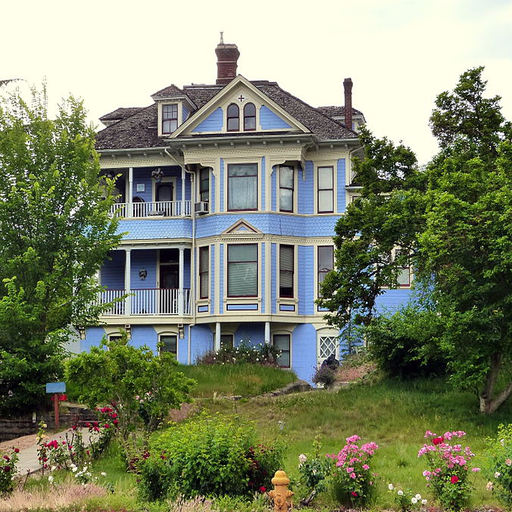

<ipython-input-57-049daaa85386>:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  latent_tensor = torch.tensor(latent)


  0%|          | 0/20 [00:00<?, ?it/s]

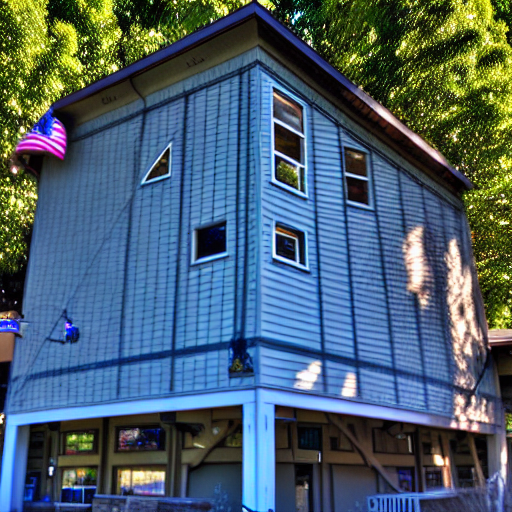

In [ ]:
def showImages(img_num, conditionGraph, dataset):
    prompt = dataset['test']['text'][img_num]
    print(prompt)
    condition_latent = dataset['test']['latent'][img_num]
    dataset['test']['image'][img_num].show()
    condition_latent = torch.tensor(dataset['test']['latent'][img_num])
    condition_latent = expand_latent(condition_latent)

    # generate image
    generator = torch.manual_seed(0)
    image = pipe(
        prompt, num_inference_steps=20, guidance_scale = 20, generator=generator, image=conditionGraph,  conditioning_latent = condition_latent
    ).images[0]

    image.show()

showImages(3, control_image, dataset)

Alphaxideltasororitychapterhouse Urbana Illinois


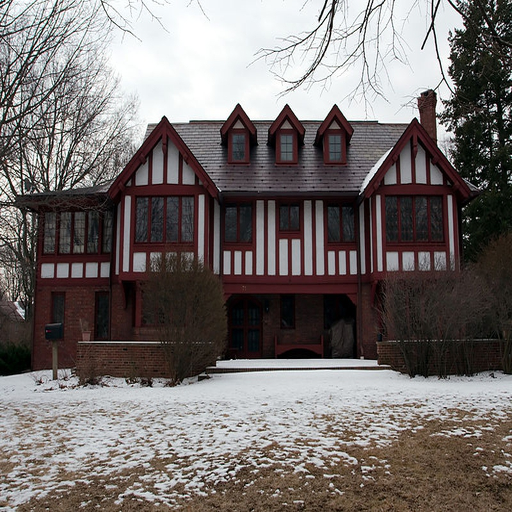

<ipython-input-57-049daaa85386>:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  latent_tensor = torch.tensor(latent)


  0%|          | 0/20 [00:00<?, ?it/s]

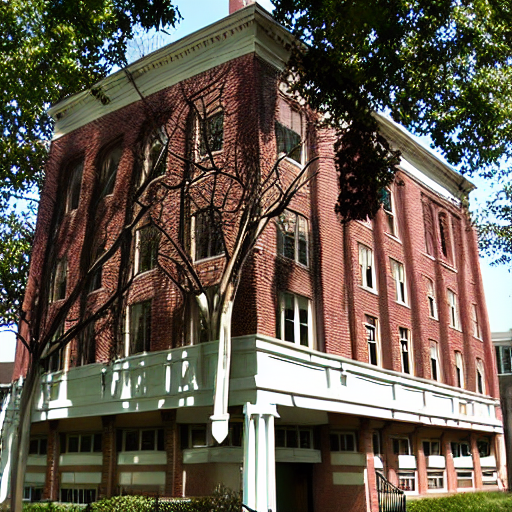

In [ ]:
showImages(5, control_image, dataset)

Ashton Memorial   Geograph


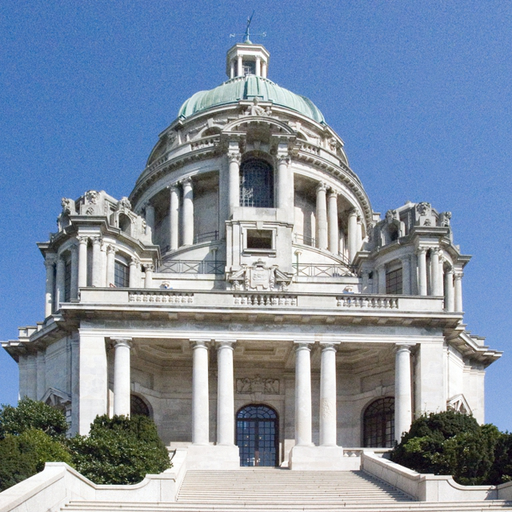

<ipython-input-57-049daaa85386>:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  latent_tensor = torch.tensor(latent)


  0%|          | 0/20 [00:00<?, ?it/s]

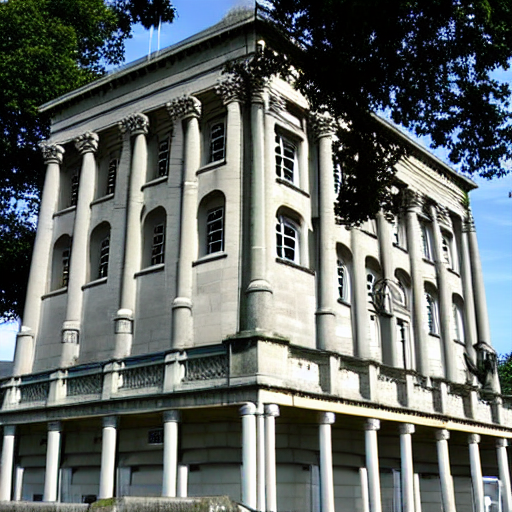

In [ ]:
showImages(11, control_image, dataset)

Capnikarea Church At Athens


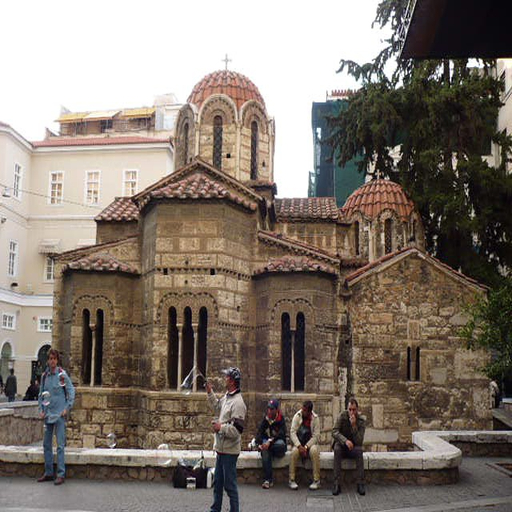

<ipython-input-57-049daaa85386>:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  latent_tensor = torch.tensor(latent)


  0%|          | 0/20 [00:00<?, ?it/s]

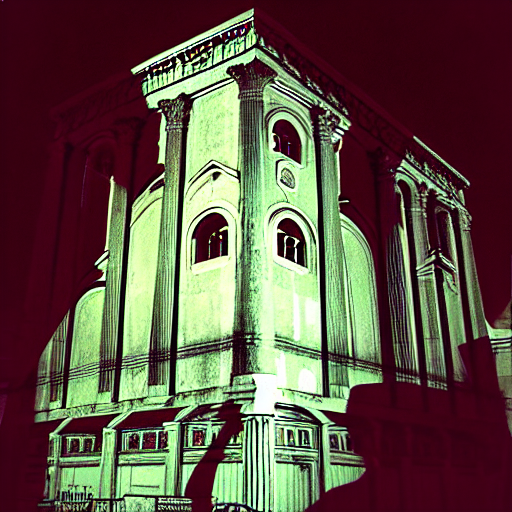

In [ ]:
showImages(50, control_image, dataset)

In [ ]:
image.save("/content/output.png")

#Data Exploration

In [ ]:
!cp '/content/drive/MyDrive/Project/arcDatasetCombined.zip' /content/
!unzip /content/arcDatasetCombined.zip

Streaming output truncated to the last 5000 lines.
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/1137_800px-Park_Avenue_2C_405-407_2C_Feltus_Duplex_2C_University_Courts.jpg  
  inflating: __MACOSX/arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/._1137_800px-Park_Avenue_2C_405-407_2C_Feltus_Duplex_2C_University_Courts.jpg  
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/1229_800px-Jordan_Avenue_South_2C_530_2C_Elm_Heights_HD.jpg  
  inflating: __MACOSX/arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/._1229_800px-Jordan_Avenue_South_2C_530_2C_Elm_Heights_HD.jpg  
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/1503_450px-Liberty_London_20.jpg  
  inflating: __MACOSX/arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/._1503_450px-Liberty_London_20.jpg  
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival archi

Loading dataset...
0 Postmodern architecture
105
1 Deconstructivism
156
2 Edwardian architecture
65
3 Achaemenid architecture
50
4 Queen Anne architecture
323
5 American craftsman style
153
6 Byzantine architecture
83
7 Ancient Egyptian architecture
211
8 Tudor Revival architecture
129
9 Greek Revival architecture
253
10 Russian Revival architecture
127
11 Romanesque architecture
73
12 Beaux-Arts architecture
122
13 International style
157
14 Art Nouveau architecture
326
15 Art Deco architecture
227
16 Gothic architecture
108
17 Palladian architecture
82
18 Novelty architecture
157
19 Colonial architecture
105
20 Bauhaus architecture
72
21 Georgian architecture
139
22 Baroque architecture
159
23 Chicago school architecture
112
24 American Foursquare architecture
34
Computing latent space projection...
Computing t-SNE embedding...
Plotting t-SNE visualization...


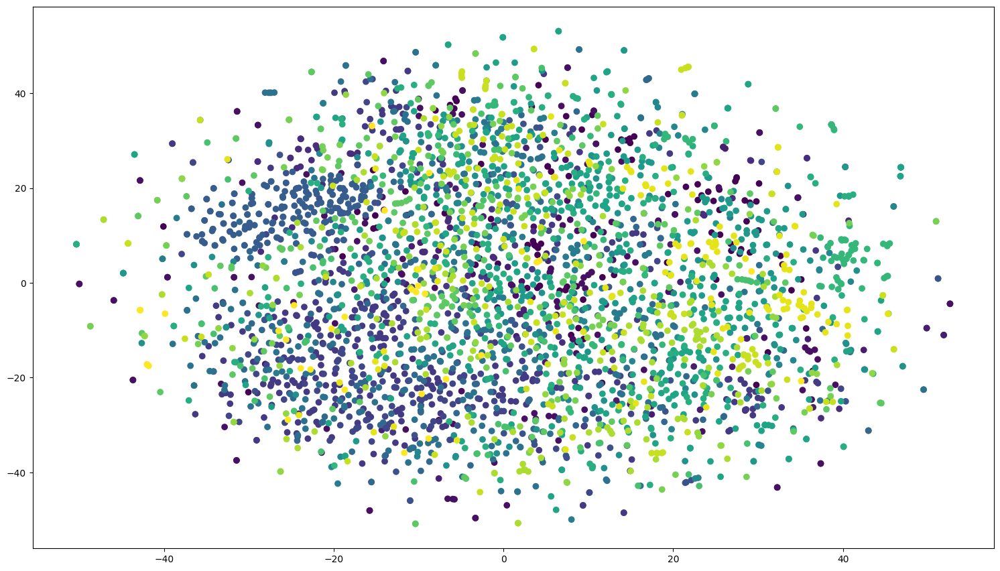

In [ ]:
import os
import sys
import h5py
import cv2
import math
import random, string
from PIL import Image

import numpy as np
from scipy.stats import norm
from sklearn import manifold
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
from google.colab.patches import cv2_imshow


# from model import get_models
# from config import latent_dim, img_size, visuals_path
# from tools import load_dataset
img_size=512
# Show every image, good for picking interplation candidates
def visualizeDataset(X):
    for i,image in enumerate(X):
        cv2_imshow(image)
        # cv2.waitKey()
        # cv2.destroyAllWindows()

# Scatter with images instead of points
def imscatter(x, y, ax, imageData, zoom):
    images = []
    for i in range(len(x)):
        x0, y0 = x[i], y[i]
        # Convert to image
        # img = imageData[i]*255.
        img=imageData[i]
        img = img.astype(np.uint8).reshape([img_size,img_size,3])
        img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
        # Note: OpenCV uses BGR and plt uses RGB
        image = OffsetImage(img, zoom=zoom)
        ab = AnnotationBbox(image, (x0, y0), xycoords='data', frameon=False)
        images.append(ax.add_artist(ab))
    
    ax.update_datalim(np.column_stack([x, y]))
    ax.autoscale()

def imscatter2(x, y, ax, imageData, zoom):
    # images = []
    # for i in range(len(x)):
        # x0, y0 = x[i], y[i]
        # Convert to image
        # img = imageData[i]*255.
        # img=imageData[i]
        # img = img.astype(np.uint8).reshape([img_size,img_size,3])
        # img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
        # Note: OpenCV uses BGR and plt uses RGB
        # image = OffsetImage(img, zoom=zoom)
    plt.scatter(x, y, c=imageData)
        # ab = AnnotationBbox(image, (x0, y0), xycoords='data', frameon=False)
        # images.append(ax.add_artist(ab))
    
    ax.update_datalim(np.column_stack([x, y]))
    ax.autoscale()

# Show dataset images with T-sne projection of latent space encoding
def computeTSNEProjectionOfLatentSpace(X,X_encoded, display=True):
    # Compute latent space representation
    print("Computing latent space projection...")
    # X_encoded = encoder.predict(X)

    # Compute t-SNE embedding of latent space
    print("Computing t-SNE embedding...")
    tsne = manifold.TSNE(n_components=2, init='pca', random_state=0)
    X_tsne = tsne.fit_transform(X_encoded)

    # Plot images according to t-sne embedding
    if display:
        print("Plotting t-SNE visualization...")
        fig, ax = plt.subplots()
        fig.set_size_inches(18.5, 10.5)
        # imscatter(X_tsne[:, 0], X_tsne[:, 1], imageData=X, ax=ax, zoom=0.1)
        imscatter2(X_tsne[:, 0], X_tsne[:, 1], imageData=X, ax=ax, zoom=0.1)
        plt.show()
        return X_tsne
    else:
        return X_tsne

# Show dataset images with T-sne projection of pixel space
def computeTSNEProjectionOfPixelSpace(X, display=True):
    # Compute t-SNE embedding of latent space
    print("Computing t-SNE embedding...")
    tsne = manifold.TSNE(n_components=2, init='pca', random_state=0)
    X_tsne = tsne.fit_transform(X.reshape([-1,img_size*img_size*3]))

    # Plot images according to t-sne embedding
    if display:
        print("Plotting t-SNE visualization...")
        fig, ax = plt.subplots()
        imscatter(X_tsne[:, 0], X_tsne[:, 1], imageData=X, ax=ax, zoom=0.01)
        plt.show()
    else:
        return X_tsne

# Reconstructions for samples in dataset
def getReconstructedImages(X, autoencoder):
    nbSamples = X.shape[0]
    nbSquares = int(math.sqrt(nbSamples))
    nbSquaresHeight = 2*nbSquares
    nbSquaresWidth = nbSquaresHeight
    resultImage = np.zeros((nbSquaresHeight*img_size,nbSquaresWidth*img_size/2,X.shape[-1]))

    reconstructedX = autoencoder.predict(X)

    for i in range(nbSamples):
        original = X[i]
        reconstruction = reconstructedX[i]
        rowIndex = i%nbSquaresWidth
        columnIndex = (i-rowIndex)/nbSquaresHeight
        resultImage[rowIndex*img_size:(rowIndex+1)*img_size,columnIndex*2*img_size:(columnIndex+1)*2*img_size,:] = np.hstack([original,reconstruction])

    return resultImage

# Reconstructions for samples in dataset
def visualizeReconstructedImages(X_train, X_test, autoencoder, save=False, label=False):
    trainReconstruction = getReconstructedImages(X_train,autoencoder)
    testReconstruction = getReconstructedImages(X_test,autoencoder)

    if not save:
        print("Generating 10 image reconstructions...")

    result = np.hstack([trainReconstruction,np.zeros([trainReconstruction.shape[0],5,trainReconstruction.shape[-1]]),testReconstruction])
    result = (result*255.).astype(np.uint8)

    if save:
        cv2.imwrite(visuals_path+"reconstructions_{}.png".format(label),result)
    else:
        cv2.imshow("Reconstructed images (train - test)",result)
        cv2.waitKey()
        cv2.destroyAllWindows()

# Computes A, B, C, A+B, A+B-C in latent space
def visualizeArithmetics(a, b, c, encoder, decoder):
    print("Computing arithmetics...")
    # Create micro batch
    X = np.array([a,b,c])

    # Compute latent space projection
    latentA, latentB, latentC = encoder.predict(X)

    add = latentA+latentB
    addSub = latentA+latentB-latentC

    # Create micro batch
    X = np.array([latentA,latentB,latentC,add,addSub])

    # Compute reconstruction
    reconstructedA, reconstructedB, reconstructedC, reconstructedAdd, reconstructedAddSub = decoder.predict(X)

    cv2.imshow("Arithmetics in latent space",np.hstack([reconstructedA, reconstructedB, reconstructedC, reconstructedAdd, reconstructedAddSub]))
    cv2.waitKey()

# Shows linear inteprolation in image space vs latent space
def visualizeInterpolation(start, end, encoder, decoder, save=False, nbSteps=5):
    print("Generating interpolations...")

    # Create micro batch
    X = np.array([start,end])

    # Compute latent space projection
    latentX = encoder.predict(X)
    latentStart, latentEnd = latentX

    # Get original image for comparison
    startImage, endImage = X

    vectors = []
    normalImages = []
    #Linear interpolation
    alphaValues = np.linspace(0, 1, nbSteps)
    for alpha in alphaValues:
        # Latent space interpolation
        vector = latentStart*(1-alpha) + latentEnd*alpha
        vectors.append(vector)
        # Image space interpolation
        blendImage = cv2.addWeighted(startImage,1-alpha,endImage,alpha,0)
        normalImages.append(blendImage)

    # Decode latent space vectors
    vectors = np.array(vectors)
    reconstructions = decoder.predict(vectors)

    # Put final image together
    resultLatent = None
    resultImage = None

    if save:
        hashName = ''.join(random.choice(string.lowercase) for i in range(3))

    for i in range(len(reconstructions)):
        interpolatedImage = normalImages[i]*255
        interpolatedImage = cv2.resize(interpolatedImage,(50,50))
        interpolatedImage = interpolatedImage.astype(np.uint8)
        resultImage = interpolatedImage if resultImage is None else np.hstack([resultImage,interpolatedImage])

        reconstructedImage = reconstructions[i]*255.
        reconstructedImage = reconstructedImage.reshape([28,28])
        reconstructedImage = cv2.resize(reconstructedImage,(50,50))
        reconstructedImage = reconstructedImage.astype(np.uint8)
        resultLatent = reconstructedImage if resultLatent is None else np.hstack([resultLatent,reconstructedImage])
    
        if save:
            cv2.imwrite(visuals_path+"{}_{}.png".format(hashName,i),np.hstack([interpolatedImage,reconstructedImage]))

        result = np.vstack([resultImage,resultLatent])

    if not save:
        cv2.imshow("Interpolation in Image Space vs Latent Space",result)
        cv2.waitKey()
        cv2.destroyAllWindows()

if __name__ == "__main__":
    # Load dataset to test
    print("Loading dataset...")
    path = "/content/arcDatasetCombined/data/arcDataset_resize"
    path_l = "/content/arcDatasetCombined/data/arcDataset_resize_latent"
    dirs = os.listdir(path)
    images=[]
    latents=[]
    cats=[]
    dirs=dirs[:3]+dirs[4:]
    for ind,item in enumerate(dirs):
      print(ind,item)
      count=0
      if os.path.isdir(path+'/'+item):
       
       dirs2 = os.listdir(path+'/'+item)
       path2=path+"/"+item+"/"
       path3=path_l+"/"+item+"/"
       for item2 in dirs2:
       
        if os.path.isfile(path2+item2):
            # print(path2+item2)
            file_path, extension = os.path.splitext(path+item2)
            # print(extension)
            if extension != '.jpg':
                continue
            images.append(cv2.imread(path2+item2))
            cats.append(ind)
            latents.append(np.load(path3+item2[:-3]+'npy')[0])
            count+=1
       print(count)
        # if count>300:
          # break

    # X_train, X_test = load_dataset()
    # computeTSNEProjectionOfPixelSpace(np.array(images[:50]))
    tsne=computeTSNEProjectionOfLatentSpace(np.array(cats),np.array(latents))



<ipython-input-31-90a96c5bd2ff>:33: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)


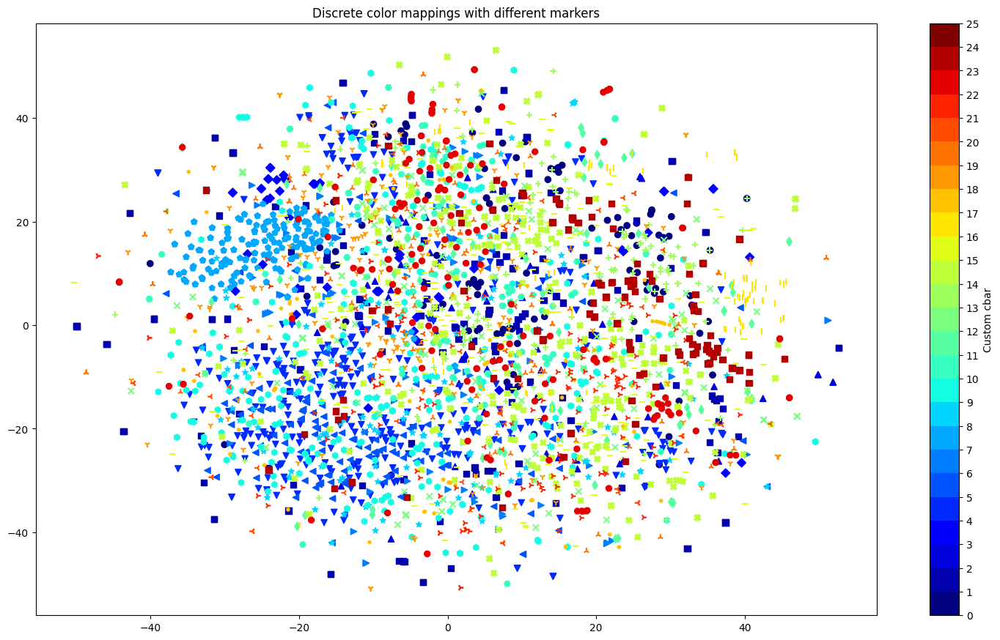

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

# define the colormap and marker list
cats=np.array(cats)
cmap = plt.cm.jet
markers = ['o', 's', '^', 'D', 'v', '<', '>', 'p', '*', 'h', 'H', 'd', 'x', '+', 'X', '_', '|', '.', '1', '2', '3', '4', '8', 's']

# extract all colors from the .jet map
cmaplist = [cmap(i) for i in range(cmap.N)]
# create the new map
cmap = cmap.from_list('Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
N = 25
bounds = np.linspace(0, N, N+1)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

# generate random data
# tsne = np.random.rand(N, 2)
# cats = np.random.randint(0, len(markers), size=N)

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
fig.set_size_inches(18.5, 10.5)

# plot the scatter plot with different markers for each class
for i in range(len(markers)):
    mask = cats == i
    ax.scatter(tsne[mask, 0], tsne[mask, 1], marker=markers[i], c=np.array(cats)[mask], cmap=cmap, norm=norm)

# create the colorbar
cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)
cb.set_label('Custom cbar')
ax.set_title('Discrete color mappings with different markers')
plt.show()


<ipython-input-47-7bf4ae5c42fd>:33: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)


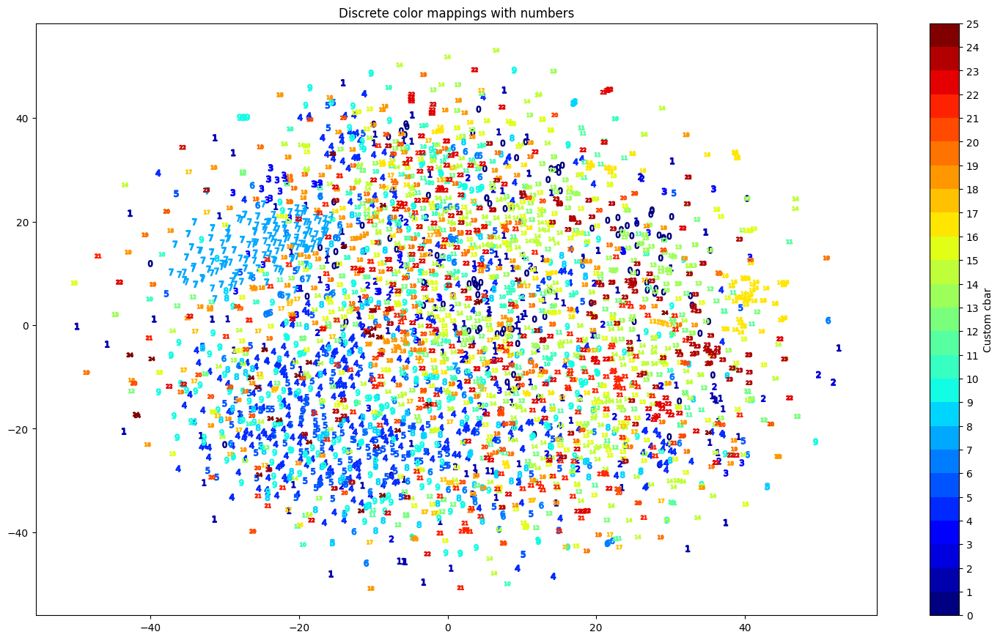

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

# define the colormap and number list
cmap = plt.cm.jet
numbers = np.arange(0, 25)

# extract all colors from the .jet map
cmaplist = [cmap(i) for i in range(cmap.N)]
# create the new map
cmap = cmap.from_list('Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
N = 25
bounds = np.linspace(0, N, N+1)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

# generate random data
# tsne = np.random.rand(N, 2)
# cats = np.random.randint(0, len(numbers), size=N)

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
fig.set_size_inches(18.5, 10.5)

# plot the scatter plot with numbers for each class
# numbers=[7]
for i in range(len(numbers)):
    mask = cats == i
    ax.scatter(tsne[mask, 0], tsne[mask, 1], marker="${}$".format(numbers[i]), c=np.array(cats)[mask], cmap=cmap, norm=norm)

# create the colorbar
cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)
cb.set_label('Custom cbar')
ax.set_title('Discrete color mappings with numbers')
plt.show()


<ipython-input-62-7a1847c9928d>:34: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)


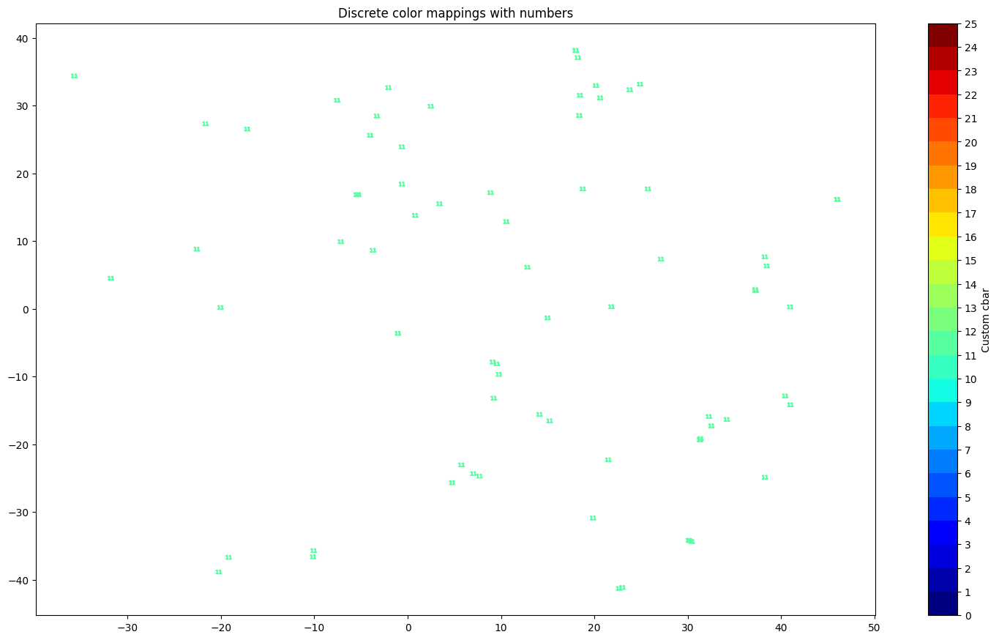

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

# define the colormap and number list
cmap = plt.cm.jet
numbers = np.arange(0, 25)

# extract all colors from the .jet map
cmaplist = [cmap(i) for i in range(cmap.N)]
# create the new map
cmap = cmap.from_list('Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
N = 25
bounds = np.linspace(0, N, N+1)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

# generate random data
# tsne = np.random.rand(N, 2)
# cats = np.random.randint(0, len(numbers), size=N)

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
fig.set_size_inches(18.5, 10.5)

# plot the scatter plot with numbers for each class
# numbers=[7]
i=10
# for i in range(len(numbers)):
mask = cats == i
ax.scatter(tsne[mask, 0], tsne[mask, 1], marker="${}$".format(i), c=np.array(cats)[mask], cmap=cmap, norm=norm)

# create the colorbar
cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)
cb.set_label('Custom cbar')
ax.set_title('Discrete color mappings with numbers')
plt.show()


<ipython-input-63-3de1ddd3013b>:33: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)


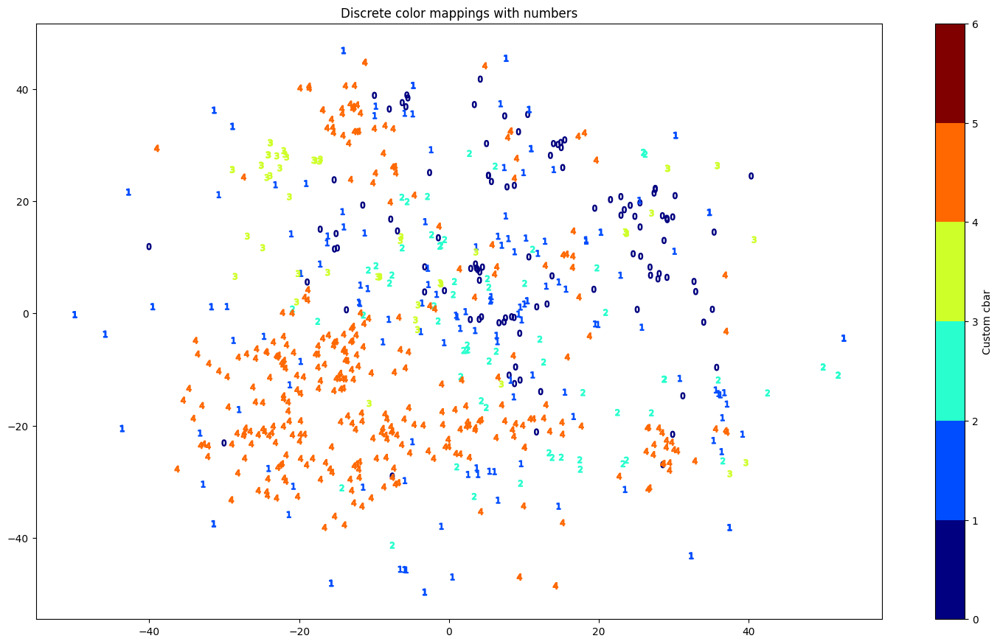

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

# define the colormap and number list
cmap = plt.cm.jet
numbers = np.arange(0, 5)

# extract all colors from the .jet map
cmaplist = [cmap(i) for i in range(cmap.N)]
# create the new map
cmap = cmap.from_list('Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
N = 6
bounds = np.linspace(0, N, N+1)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

# generate random data
# tsne = np.random.rand(N, 2)
# cats = np.random.randint(0, len(numbers), size=N)

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
fig.set_size_inches(18.5, 10.5)

# plot the scatter plot with numbers for each class
# numbers=[7]
for i in range(len(numbers)):
    mask = cats == i
    ax.scatter(tsne[mask, 0], tsne[mask, 1], marker="${}$".format(numbers[i]), c=np.array(cats)[mask], cmap=cmap, norm=norm)

# create the colorbar
cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)
cb.set_label('Custom cbar')
ax.set_title('Discrete color mappings with numbers')
plt.show()


<ipython-input-64-3af791cbd001>:33: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)


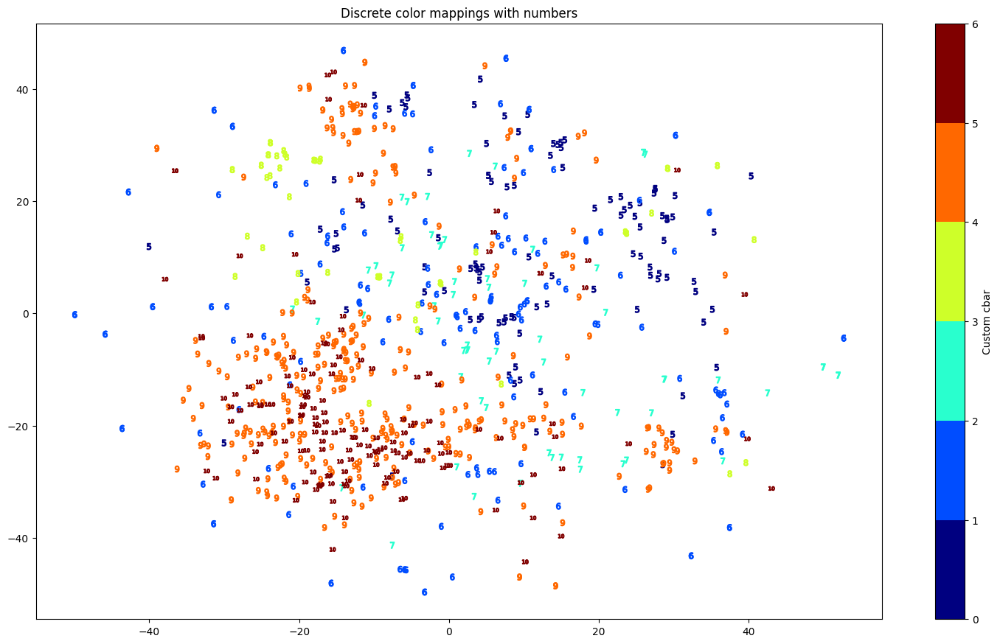

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

# define the colormap and number list
cmap = plt.cm.jet
numbers = np.arange(5, 11)

# extract all colors from the .jet map
cmaplist = [cmap(i) for i in range(cmap.N)]
# create the new map
cmap = cmap.from_list('Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
N = 6
bounds = np.linspace(0, N, N+1)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

# generate random data
# tsne = np.random.rand(N, 2)
# cats = np.random.randint(0, len(numbers), size=N)

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
fig.set_size_inches(18.5, 10.5)

# plot the scatter plot with numbers for each class
# numbers=[7]
for i in range(len(numbers)):
    mask = cats == i
    ax.scatter(tsne[mask, 0], tsne[mask, 1], marker="${}$".format(numbers[i]), c=np.array(cats)[mask], cmap=cmap, norm=norm)

# create the colorbar
cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)
cb.set_label('Custom cbar')
ax.set_title('Discrete color mappings with numbers')
plt.show()


<ipython-input-65-59c55cc9f1d6>:33: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)


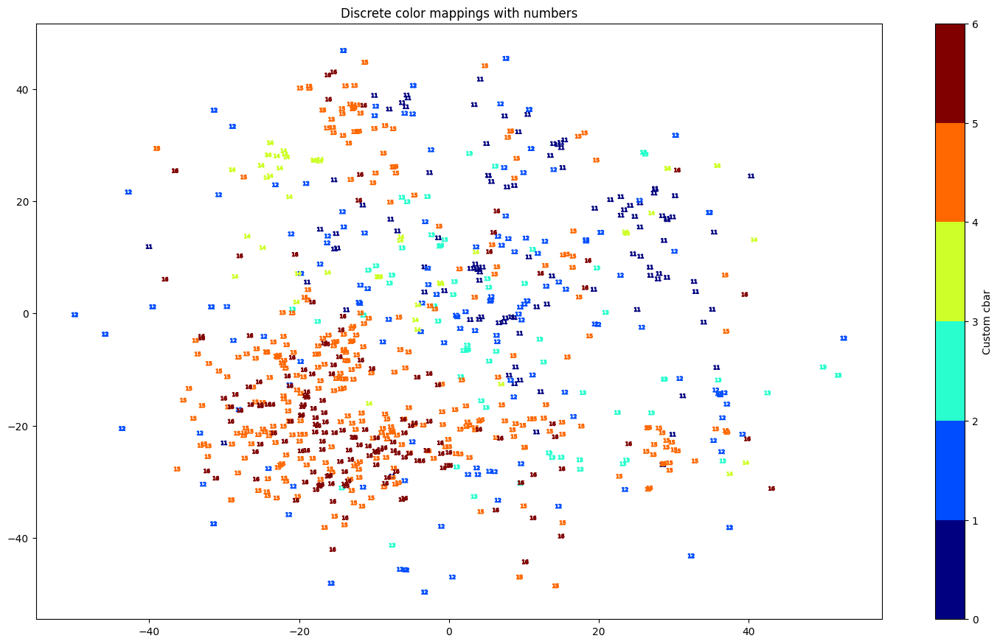

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

# define the colormap and number list
cmap = plt.cm.jet
numbers = np.arange(11,17)

# extract all colors from the .jet map
cmaplist = [cmap(i) for i in range(cmap.N)]
# create the new map
cmap = cmap.from_list('Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
N = 6
bounds = np.linspace(0, N, N+1)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

# generate random data
# tsne = np.random.rand(N, 2)
# cats = np.random.randint(0, len(numbers), size=N)

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
fig.set_size_inches(18.5, 10.5)

# plot the scatter plot with numbers for each class
# numbers=[7]
for i in range(len(numbers)):
    mask = cats == i
    ax.scatter(tsne[mask, 0], tsne[mask, 1], marker="${}$".format(numbers[i]), c=np.array(cats)[mask], cmap=cmap, norm=norm)

# create the colorbar
cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)
cb.set_label('Custom cbar')
ax.set_title('Discrete color mappings with numbers')
plt.show()


<ipython-input-66-a60555b9762c>:33: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)


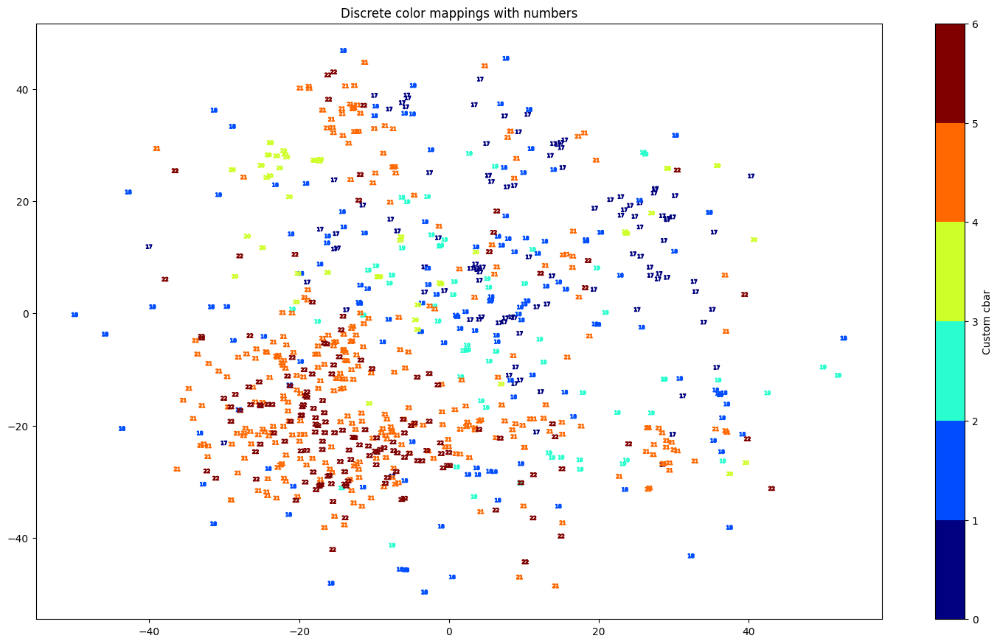

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

# define the colormap and number list
cmap = plt.cm.jet
numbers = np.arange(17, 23)

# extract all colors from the .jet map
cmaplist = [cmap(i) for i in range(cmap.N)]
# create the new map
cmap = cmap.from_list('Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
N = 6
bounds = np.linspace(0, N, N+1)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

# generate random data
# tsne = np.random.rand(N, 2)
# cats = np.random.randint(0, len(numbers), size=N)

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
fig.set_size_inches(18.5, 10.5)

# plot the scatter plot with numbers for each class
# numbers=[7]
for i in range(len(numbers)):
    mask = cats == i
    ax.scatter(tsne[mask, 0], tsne[mask, 1], marker="${}$".format(numbers[i]), c=np.array(cats)[mask], cmap=cmap, norm=norm)

# create the colorbar
cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)
cb.set_label('Custom cbar')
ax.set_title('Discrete color mappings with numbers')
plt.show()


<ipython-input-67-93313feafc4f>:33: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)


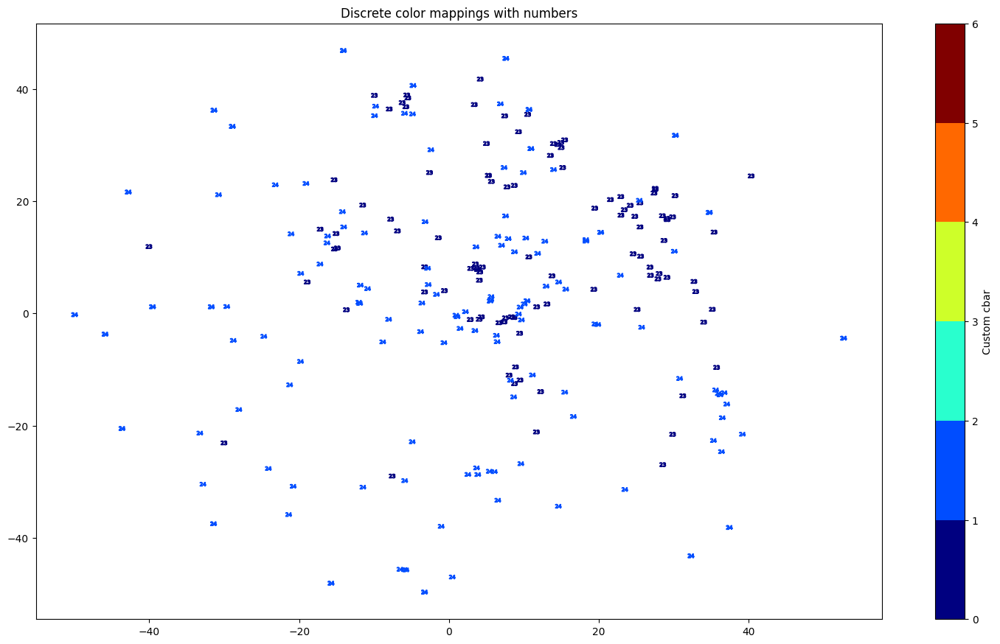

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

# define the colormap and number list
cmap = plt.cm.jet
numbers = np.arange(23, 25)

# extract all colors from the .jet map
cmaplist = [cmap(i) for i in range(cmap.N)]
# create the new map
cmap = cmap.from_list('Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
N = 6
bounds = np.linspace(0, N, N+1)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

# generate random data
# tsne = np.random.rand(N, 2)
# cats = np.random.randint(0, len(numbers), size=N)

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
fig.set_size_inches(18.5, 10.5)

# plot the scatter plot with numbers for each class
# numbers=[7]
for i in range(len(numbers)):
    mask = cats == i
    ax.scatter(tsne[mask, 0], tsne[mask, 1], marker="${}$".format(numbers[i]), c=np.array(cats)[mask], cmap=cmap, norm=norm)

# create the colorbar
cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), spacing='proportional', ticks=bounds)
cb.set_label('Custom cbar')
ax.set_title('Discrete color mappings with numbers')
plt.show()


#latent classfier

In [8]:
!cp '/content/drive/MyDrive/Project/arcDatasetCombined.zip' /content/
!unzip /content/arcDatasetCombined.zip

Streaming output truncated to the last 5000 lines.
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/1137_800px-Park_Avenue_2C_405-407_2C_Feltus_Duplex_2C_University_Courts.jpg  
  inflating: __MACOSX/arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/._1137_800px-Park_Avenue_2C_405-407_2C_Feltus_Duplex_2C_University_Courts.jpg  
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/1229_800px-Jordan_Avenue_South_2C_530_2C_Elm_Heights_HD.jpg  
  inflating: __MACOSX/arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/._1229_800px-Jordan_Avenue_South_2C_530_2C_Elm_Heights_HD.jpg  
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/1503_450px-Liberty_London_20.jpg  
  inflating: __MACOSX/arcDatasetCombined/data/arcDataset_resize/Tudor Revival architecture/._1503_450px-Liberty_London_20.jpg  
  inflating: arcDatasetCombined/data/arcDataset_resize/Tudor Revival archi

In [13]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import numpy as np
import os
import pandas as pd
from torch.utils.data.dataloader import default_collate


class MLPClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_classes):
        super(MLPClassifier, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size, num_classes)

    def forward(self, x):
        out = self.fc1(x)
        out = self.relu(out)
        out = self.fc2(out)
        return out

class CustomDataset(Dataset):
    def __init__(self, folder_path, csv_file):
        self.folder_path = folder_path
        self.data = pd.read_csv(csv_file)
        self._filter_missing_files()

    def _filter_missing_files(self):
        valid_indices = []
        for idx in range(len(self.data)):
            file_name = self.data.iloc[idx, 0][:-3]+'npy'
            file_path = os.path.join(self.folder_path, file_name)
            if os.path.exists(file_path):
                valid_indices.append(idx)
        self.data = self.data.iloc[valid_indices]
        print(self.data.shape)


    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        try:
          file_name = self.data.iloc[idx, 0][:-3]+'npy'
          label = self.data.iloc[idx, 2]
          file_path = os.path.join(self.folder_path, file_name)
          features = np.load(file_path)[0]
          return torch.from_numpy(features).float(), torch.tensor(label).long()
        except Exception as e:
            print(e)
# def my_collate(batch):
#     batch = filter (lambda x:x is not None, batch)
#     return default_collate(batch)
# Define the hyperparameters
input_size = 768
hidden_size = 256
num_classes = 26
learning_rate = 0.001
num_epochs = 10
batch_size = 32

# Create the MLP classifier
model = MLPClassifier(input_size, hidden_size, num_classes)

# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Create a custom dataset and data loader
dataset = CustomDataset(folder_path='/content/arcDatasetCombined/data/arcDataset_resize_latent', csv_file='/content/arcDatasetCombined/data/train.csv')
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Training loop
total_samples = len(dataset)
for epoch in range(num_epochs):
    for i, (batch, labels) in enumerate(dataloader):
        inputs = batch  # The batch of input features
        labels = labels  # The batch of labels

        # Forward pass
        outputs = model(inputs)
        # print(outputs.shape)
        # print(labels.shape)
        loss = criterion(outputs, labels)
        print(loss)
        # Backward and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Print the loss for every few iterations
        if (i+1) % 10 == 0:
            print(f'Epoch [{epoch+1}/{num_epochs}], Step [{i+1}/{total_samples//batch_size}], Loss: {loss.item():.4f}')


(1994, 3)
tensor(3.2603, grad_fn=<NllLossBackward0>)
tensor(3.1761, grad_fn=<NllLossBackward0>)
tensor(3.1386, grad_fn=<NllLossBackward0>)
tensor(3.1704, grad_fn=<NllLossBackward0>)
tensor(3.1250, grad_fn=<NllLossBackward0>)
tensor(3.1445, grad_fn=<NllLossBackward0>)
tensor(3.0211, grad_fn=<NllLossBackward0>)
tensor(2.9597, grad_fn=<NllLossBackward0>)
tensor(3.0899, grad_fn=<NllLossBackward0>)
tensor(3.0769, grad_fn=<NllLossBackward0>)
Epoch [1/10], Step [10/62], Loss: 3.0769
tensor(2.9435, grad_fn=<NllLossBackward0>)
tensor(2.8183, grad_fn=<NllLossBackward0>)
tensor(2.9459, grad_fn=<NllLossBackward0>)
tensor(2.9610, grad_fn=<NllLossBackward0>)
tensor(2.8757, grad_fn=<NllLossBackward0>)
tensor(2.7897, grad_fn=<NllLossBackward0>)
tensor(2.7797, grad_fn=<NllLossBackward0>)
tensor(2.6941, grad_fn=<NllLossBackward0>)
tensor(2.8091, grad_fn=<NllLossBackward0>)
tensor(2.6202, grad_fn=<NllLossBackward0>)
Epoch [1/10], Step [20/62], Loss: 2.6202
tensor(2.6505, grad_fn=<NllLossBackward0>)
tenso

In [14]:
# Assuming you have already trained and saved the model, you can load it as follows:
# model = torch.load('path_to_saved_model')

# Create the test dataset and data loader
test_dataset = CustomDataset(folder_path='/content/arcDatasetCombined/data/arcDataset_resize_latent', csv_file='/content/arcDatasetCombined/data/test.csv')
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Evaluation loop
model.eval()  # Set the model to evaluation mode
total_samples = len(test_dataset)
total_correct = 0

with torch.no_grad():  # Disable gradient calculation during evaluation
    for i, (batch, labels) in enumerate(test_dataloader):
        inputs = batch  # The batch of input features
        labels = labels  # The batch of labels

        # Forward pass
        outputs = model(inputs)
        _, predicted = torch.max(outputs, 1)

        # Count total correct predictions
        total_correct += (predicted == labels).sum().item()

accuracy = total_correct / total_samples
print(f'Test Accuracy: {accuracy * 100:.2f}%')


(487, 3)
Test Accuracy: 53.39%
